In [1]:
import sys, os
if 'google.colab' in sys.modules:
    # mount google drive
    from google.colab import drive
    drive.mount('/content/gdrive')
    # specify the path of the folder containing "file_name" :
    path_to_file = '/content/gdrive/My Drive/explainable_ai/notebooks'
    print(path_to_file)
    # change current path to the folder containing "file_name"
    os.chdir(path_to_file)
    !pwd

Mounted at /content/gdrive
/content/gdrive/My Drive/explainable_ai/notebooks
/content/gdrive/My Drive/explainable_ai/notebooks


In [2]:
!pip install shap
!pip install eli5

     |████████████████████████████████| 564 kB 5.3 MB/s eta 0:00:01
     |████████████████████████████████| 106 kB 5.3 MB/s 


In [158]:
import pandas as pd
import numpy as np

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn import model_selection

from sklearn.feature_selection import SelectFromModel

from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier, plot_tree

from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn import metrics
from sklearn.metrics import accuracy_score, precision_score, recall_score

import shap
shap.initjs()
import matplotlib.pyplot as plt
%matplotlib inline
pd.set_option('display.max_columns', None)

import eli5
from eli5.sklearn import PermutationImportance

import lime
import lime.lime_tabular
from lime import submodular_pick


## Load and clean data

In [2]:
# Load data
df = pd.read_csv('../datasets/final_data_cleaned_7apr_heatmap_dropped.csv', index_col = [0])
#df = df.drop(columns = ['SEQN'])

# Hanlde missing values
df.dropna(inplace=True)

print(df.shape)

(8610, 75)


In [3]:
df.head()

,Cadmium (ug/L),Lead (ug/dL),Blood manganese (ug/L),"Mercury, total (ug/L)",Blood selenium(ug/L),LDL-Cholesterol,Lymphocyte number,Monocyte number,Segmented neutrophils number,Eosinophils number,Basophils number,Red cell count SI,Hemoglobin (g/dL),Platelet count (%) SI,Glycohemoglobin (%),Insulin (uU/mL),Two Hour Glucose(OGTT) (mg/dL),Total # of Dietary Supplements Taken,Any Dietary Supplements Taken?,Energy (kcal),Protein (gm),Carbohydrate (gm),Total sugars (gm),Dietary fiber (gm),Total fat (gm),Total saturated fatty acids (gm),Total monounsaturated fatty acids (gm),Total polyunsaturated fatty acids (gm),Lycopene (mcg),Lutein + zeaxanthin (mcg),Thiamin (Vitamin B1) (mg),Riboflavin (Vitamin B2) (mg),Niacin (mg),Vitamin B6 (mg),"Folate, DFE (mcg)",Total choline (mg),Vitamin B12 (mcg),Vitamin C (mg),Vitamin K (mcg),Vitamin D (D2 + D3) (mcg),Calcium (mg),Phosphorus (mg),Magnesium (mg),Iron (mg),Zinc (mg),Copper (mg),Sodium (mg),Potassium (mg),Selenium (mcg),Caffeine (mg),Systolic: Blood pressure (first reading) mm Hg,Diastolic: Blood pressure (second reading) mm Hg,Height-Length difference flagged,Body Mass Index (kg/m**2),Grip test status,Combined grip strength (kg),Overall Oral Health Exam Status,Dental Implant: yes / no?,Tooth Count: Upper right 3rd molar (3M),How often add salt to food at table,Theobromine (mg),Gender,AgeYears,Race,Citizenship,USStayLength,MaritalStatus,PregnancyStatus,FamilyIncome,PovertyRatio,is_diabetic,large_family,college_educated,high_risk,is_healthy
SEQN,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
73559,0.22,1.45,9.57,1.27,209.64,126.0,1.0,0.8,4.9,0.4,0.1,5.53,17.2,237.0,8.9,5.83,115.55,6.75,0.0,13.43,3.80,2.78,2.09,2.09,1.88,0.99,0.97,0.98,831.79,1252.14,28.40,11.28,71.32,40.92,673.83,25.14,480.20,602.43,82.13,273.89,519.81,68.19,278.24,28.89,17.12,1.63,40.98,114.40,122.66,165.35,140.0,76.0,175.3,28.9,1.0,91.0,1.0,1.0,4.0,1.00,71.0,Male,72.0,White,1,Unknown,Married,NotApplicable,Medium,4.51,1,0.0,1.0,1,0.0
73607,0.50,1.35,8.31,0.33,219.00,161.0,2.3,0.6,3.8,0.1,0.0,4.16,13.5,152.0,5.0,17.47,113.00,6.31,0.0,14.79,3.96,3.66,3.08,2.16,1.97,1.00,0.99,1.00,841.43,1132.39,24.57,12.55,90.60,52.14,663.81,31.31,579.82,535.23,78.51,281.40,489.95,64.77,224.66,29.35,18.00,1.66,33.48,160.80,123.39,172.39,120.0,84.0,169.6,38.9,1.0,67.3,1.0,1.0,4.0,1.75,0.0,Male,75.0,White,1,Unknown,Married,NotApplicable,Low,1.08,0,0.0,0.0,0,0.0
73621,0.36,1.38,8.14,0.87,212.84,161.0,0.8,0.4,2.8,0.1,0.0,4.55,13.8,197.0,5.6,4.33,97.00,6.23,0.0,14.29,3.77,3.59,3.04,2.18,1.91,0.99,0.98,0.99,820.50,1072.40,23.71,12.54,80.34,84.59,675.32,28.60,437.70,536.39,83.61,306.22,545.06,82.41,239.08,29.92,18.17,1.68,37.28,126.33,124.23,156.40,134.0,66.0,176.2,24.6,1.0,61.2,2.0,1.0,4.0,1.61,7.0,Male,80.0,White,1,Unknown,Married,NotApplicable,Medium,5.00,1,0.0,1.0,0,0.0
73633,0.07,0.59,9.62,0.20,168.49,195.0,2.1,0.5,5.0,0.1,0.1,4.37,13.8,210.0,5.2,12.06,124.00,6.74,0.0,15.56,3.82,3.57,3.63,2.23,1.88,0.98,0.98,0.99,862.73,1070.10,25.90,13.98,73.97,28.77,678.28,21.62,384.09,442.32,76.55,268.44,532.38,80.45,232.78,29.09,15.85,2.08,44.56,132.64,126.73,165.30,142.0,82.0,158.7,30.5,1.0,51.3,1.0,1.0,4.0,1.00,37.0,Female,43.0,White,1,Unknown,Married,NotPregnant,Medium,3.56,0,1.0,1.0,0,0.0
73656,0.22,2.00,6.48,1.56,203.94,146.0,1.4,0.6,5.2,0.1,0.1,5.14,15.6,395.0,5.3,8.39,82.00,6.57,0.0,14.11,3.77,3.02,2.82,2.08,1.90,1.00,0.97,0.99,878.33,1172.07,23.92,14.22,77.44,33.05,658.11,23.97,455.34,582.83,74.60,200.33,484.88,64.10,237.72,29.28,17.27,1.67,39.00,104.54,114.81,178.48,118.0,74.0,178.0,28.0,1.0,102.9,1.0,1.0,4.0,3.00,31.0,Male,54.0,White,1,Unknown,Married,NotApplicable,High,4.25,1,1.0,1.0,0,0.0


## Train test split

In [4]:
# Define target and predictor features
y = df['is_diabetic']
X = df.drop(columns=['is_diabetic'])

# Get numeric and categorical columns
num_cols = list(X.select_dtypes(include=np.number).columns)
cat_cols = list(set(X.columns)-set(X[num_cols].columns))

# Train and test split
X_train, X_test,y_train,y_test = train_test_split(X,y,test_size =0.2, random_state = 12, stratify = y)



In [5]:
# Print categorical and numeric columns
print('Categorical columns: ', cat_cols, '\n')
print('Numeric columns: ', num_cols)

Categorical columns:  ['Gender', 'USStayLength', 'MaritalStatus', 'PregnancyStatus', 'Race', 'FamilyIncome'] 

Numeric columns:  ['Cadmium (ug/L)', 'Lead (ug/dL)', 'Blood manganese (ug/L)', 'Mercury, total (ug/L)', 'Blood selenium(ug/L)', 'LDL-Cholesterol', 'Lymphocyte number', 'Monocyte number', 'Segmented neutrophils number', 'Eosinophils number', 'Basophils number', 'Red cell count SI', 'Hemoglobin (g/dL)', 'Platelet count (%) SI', 'Glycohemoglobin (%)', 'Insulin (uU/mL)', 'Two Hour Glucose(OGTT) (mg/dL)', 'Total # of Dietary Supplements Taken', 'Any Dietary Supplements Taken?', 'Energy (kcal)', 'Protein (gm)', 'Carbohydrate (gm)', 'Total sugars (gm)', 'Dietary fiber (gm)', 'Total fat (gm)', 'Total saturated fatty acids (gm)', 'Total monounsaturated fatty acids (gm)', 'Total polyunsaturated fatty acids (gm)', 'Lycopene (mcg)', 'Lutein + zeaxanthin (mcg)', 'Thiamin (Vitamin B1) (mg)', 'Riboflavin (Vitamin B2) (mg)', 'Niacin (mg)', 'Vitamin B6 (mg)', 'Folate, DFE (mcg)', 'Total cholin

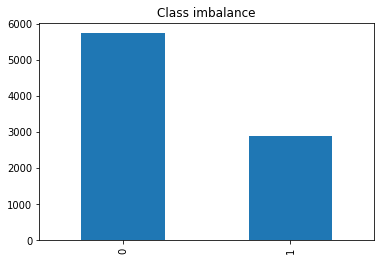

In [6]:
# See if there is Y class imbalance
df.is_diabetic.value_counts().plot(kind='bar', title='Class imbalance')
plt.show()

## Models

In [7]:
from sklearn.ensemble import RandomForestClassifier
import lightgbm as lgb
# from xgboost import XGBClassifier
from imblearn.over_sampling import SMOTE
from sklearn.linear_model import LogisticRegression
from imblearn.combine import SMOTETomek
from imblearn.pipeline import Pipeline
# from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler, RobustScaler, QuantileTransformer, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.feature_selection import RFECV
from sklearn.model_selection import GridSearchCV
from sklearn import set_config
set_config(display="diagram")

### Preprocessing & Feature selection

In [8]:
## Preprocessing and feature selection pipeline

# Preprocess
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), num_cols ),
        ("cat", Pipeline([('ohe', OneHotEncoder(handle_unknown='ignore'))]), cat_cols),
    ]
    , remainder='passthrough'
)

pipe = Pipeline([("preprocessor", preprocessor)])

X_train = pipe.fit_transform(X_train, y_train)
X_test = pipe.transform(X_test)

# Resample
sm = SMOTE()
X_train, y_train = sm.fit_resample(X_train,y_train)

# Feature selection
feature_selector = SelectFromModel(RandomForestClassifier())

X_train = feature_selector.fit_transform(X_train, y_train)
X_test = feature_selector.transform(X_test)

print('New shape: ',X_train.shape)
print('Dropped ', X.shape[1]-X_train.shape[1], ' features')


New shape:  (9170, 28)
Dropped  46  features


In [9]:
# Set column names back in dataframes
one_hot_col = list(pipe[0].named_transformers_['cat']['ohe'].get_feature_names(input_features=cat_cols))

after_ohe_cols = num_cols+one_hot_col # Total columns after one hot encoding
feature_selected_cols = np.array(after_ohe_cols)[feature_selector.get_support()]# Total columns after feature selection

X_train = pd.DataFrame(data=X_train, columns=feature_selected_cols)
X_test = pd.DataFrame(data=X_test, columns=feature_selected_cols)

Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.


### Linear SVC

Fitting 5 folds for each of 4 candidates, totalling 20 fits
---------------------------------------------------------
Best params: {'classifier__C': 0.5}
Train score:  0.7984732824427481
Test score:  0.7897793263646922
Test precission:  0.6320987654320988
Test recall:  0.8888888888888888


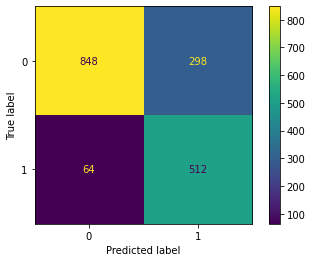

In [10]:
#Hyperparameter tuning
pipe = Pipeline([('classifier', SVC(C=0.01, kernel='linear', probability = True))])

param_grid = [
    {   
        'classifier__C':[0.01, 0.1, 0.5, 1]
    }
]

# Hyperparameter tuning and cross validation
search = GridSearchCV(pipe, param_grid, cv=5, n_jobs=8, verbose=3)


search.fit(X_train,np.ravel(y_train))
best_lsvc = search.best_estimator_[-1]

y_preds_lsvc = search.predict(X_test) 

print('---------------------------------------------------------')
print('Best params:', search.best_params_)
print("Train score: ", search.score(X_train,np.ravel(y_train)))
print("Test score: ", search.score(X_test,np.ravel(y_test)))
print("Test precission: ", precision_score(np.ravel(y_test), y_preds_lsvc))
print("Test recall: ", recall_score(np.ravel(y_test), y_preds_lsvc))


#Confusion Matrix display
cm_lsvc = confusion_matrix(y_test, y_preds_lsvc)

disp = ConfusionMatrixDisplay(confusion_matrix=cm_lsvc,
                              display_labels=[0,1])
disp.plot()

plt.show()



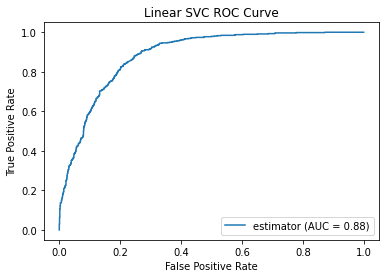

In [11]:
#ROC Curve
lsvc_probas_ = best_lsvc.predict_proba(X_test)
fpr, tpr, thresholds = metrics.roc_curve(y_test, lsvc_probas_[:, 1])
roc_auc = metrics.auc(fpr, tpr)
display = metrics.RocCurveDisplay(fpr=fpr, tpr=tpr, roc_auc=roc_auc,
                                  estimator_name='estimator')
display.plot()
plt.title("Linear SVC ROC Curve")
plt.show()

#### Model explanation

##### Default feature importance

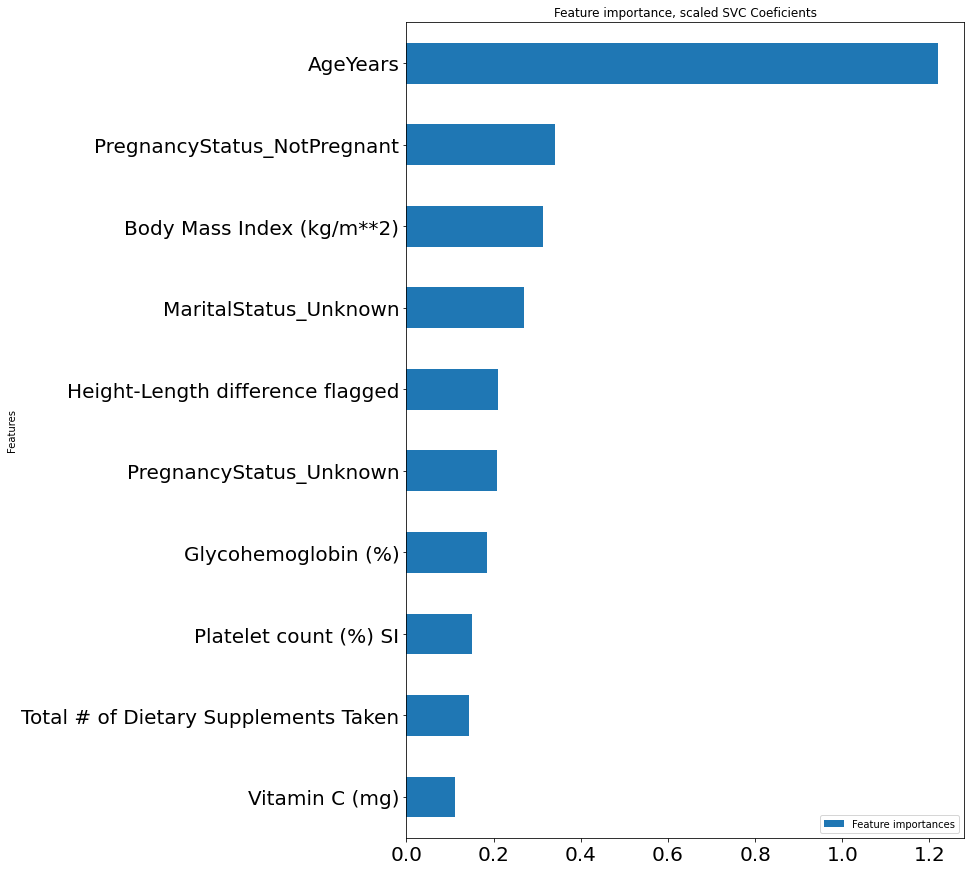

In [12]:
#Features used
feature_imp = abs(best_lsvc.coef_[0])

importance_index_lsvc = np.nonzero(feature_imp)[0]

feature_importance = pd.DataFrame({'Features':feature_selected_cols ,'Feature importances':feature_imp})
feature_importance.sort_values(by='Feature importances', ascending=False).head(10).sort_values(by='Feature importances').plot(kind='barh',x='Features',y='Feature importances', figsize=(10,15),fontsize=20, title='Feature importance, scaled SVC Coeficients')
plt.show()

##### SHAP

Global explanation

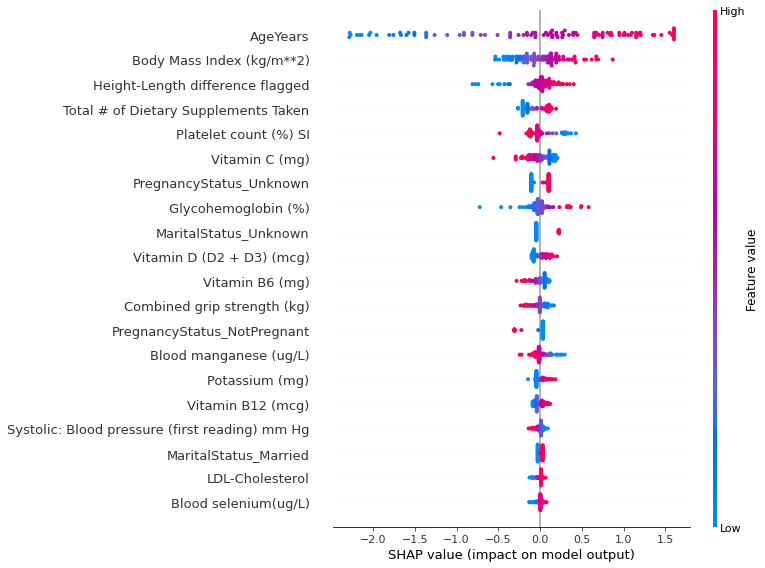

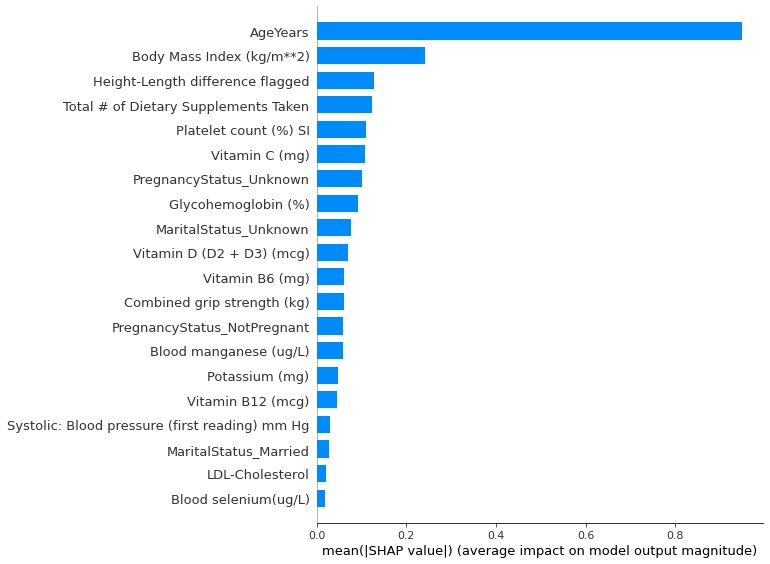

Local force plot for single sample


In [14]:
### SHAP
# Fit shap with sample of 100. Can change to 1 to visualize local data

sample_num_to_explain = 100 # How many sample points to include
class_to_explain = 1 # Explain with respect to which predictive label
single_sample_num = 0 # When plotting local explanation, which sample num

X100 = shap.utils.sample(X_train, sample_num_to_explain) # Sample to use as background distribution
explainer = shap.Explainer(best_lsvc, X100)
shap_values = explainer.shap_values(X100)

# Shap values that explain predictions on class 1  shap_values[class]
shap.summary_plot(shap_values, X100)
shap.summary_plot(shap_values, X100, plot_type="bar")

print('Local force plot for single sample')
shap.force_plot(explainer.expected_value, shap_values[single_sample_num],X100.iloc[single_sample_num] )



In [ ]:
def global_exp_lime (model,sample_size):
    X = sample_size.values
    explainer = lime.lime_tabular.LimeTabularExplainer(X,feature_names = sample_size.columns,class_names=['No Diabetes','Diabetes'],kernel_width=5)
    sp_obj = submodular_pick.SubmodularPick(explainer, sample_size.values, model.predict_proba, sample_size=5, num_features=10, num_exps_desired=5)
    #Plot the 5 explanations
    #[exp.as_pyplot_figure(label=exp.available_labels()[0]) for exp in sp_obj.sp_explanations];
    
    # Make it into a dataframe

    W_pick=pd.DataFrame([dict(this.as_list(this.available_labels()[0])) for this in sp_obj.sp_explanations]).fillna(0)

    W_pick['prediction'] = [this.available_labels()[0] for this in sp_obj.sp_explanations]

    #Making a dataframe of all the explanations of sampled points
    W=pd.DataFrame([dict(this.as_list(this.available_labels()[0])) for this in sp_obj.explanations]).fillna(0)
    W['prediction'] = [this.available_labels()[0] for this in sp_obj.explanations]

    #Plotting the aggregate importances
    np.abs(W.drop("prediction", axis=1)).mean(axis=0).sort_values(ascending=False).head(
        20
    ).sort_values(ascending=True).plot(kind='barh',x='Features',y='Feature importances',title = 'Mean Effect from LIME' , figsize=(10,15),fontsize=20)

    W['prediction'] = (W['prediction'].replace({0: 'No Diabetes', 1: 'Diabetes'}))
    #Aggregate importances split by classes
    grped_coeff = W.groupby("prediction").mean()
    grped_coeff = grped_coeff.T
    grped_coeff["abs"] = np.abs(grped_coeff.iloc[:, 0])
    grped_coeff.sort_values("abs", inplace=True, ascending=False)
    grped_coeff.head(20).sort_values("abs", ascending=True).drop("abs", axis=1).plot(kind='barh',title = 'Mean Coefficients of LIME explanation by class', figsize=(10,15),fontsize=20)

##### LIME

X does not have valid feature names, but SVC was fitted with feature names
X does not have valid feature names, but SVC was fitted with feature names
X does not have valid feature names, but SVC was fitted with feature names
X does not have valid feature names, but SVC was fitted with feature names
X does not have valid feature names, but SVC was fitted with feature names


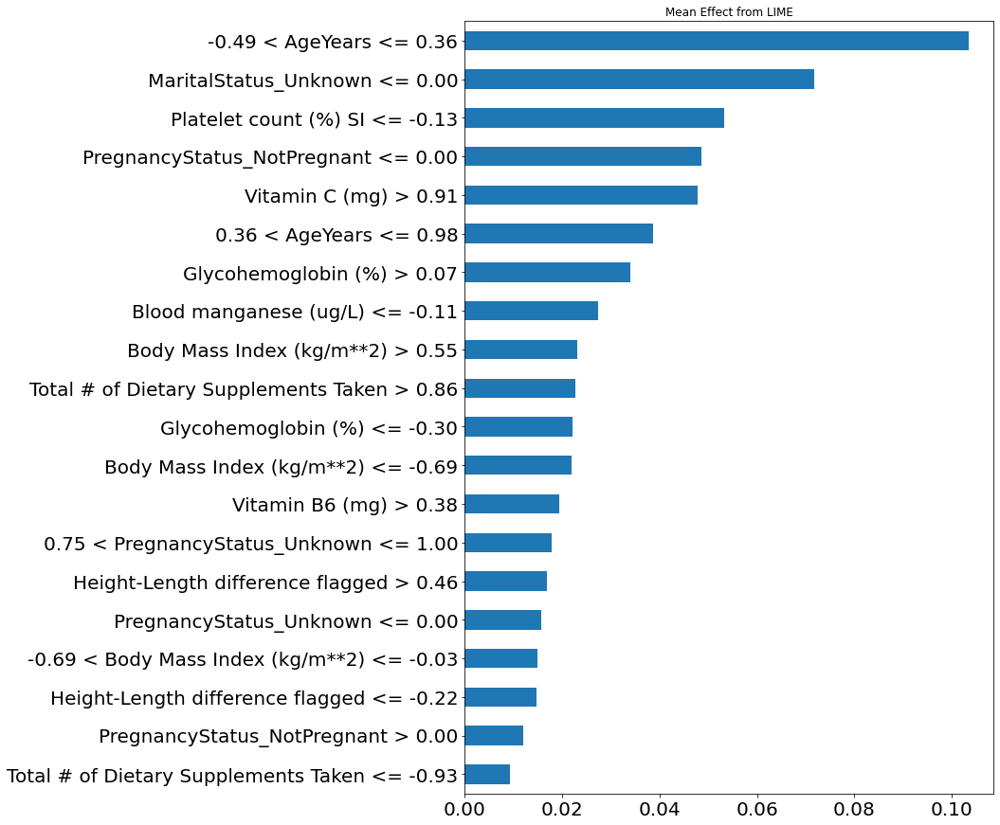

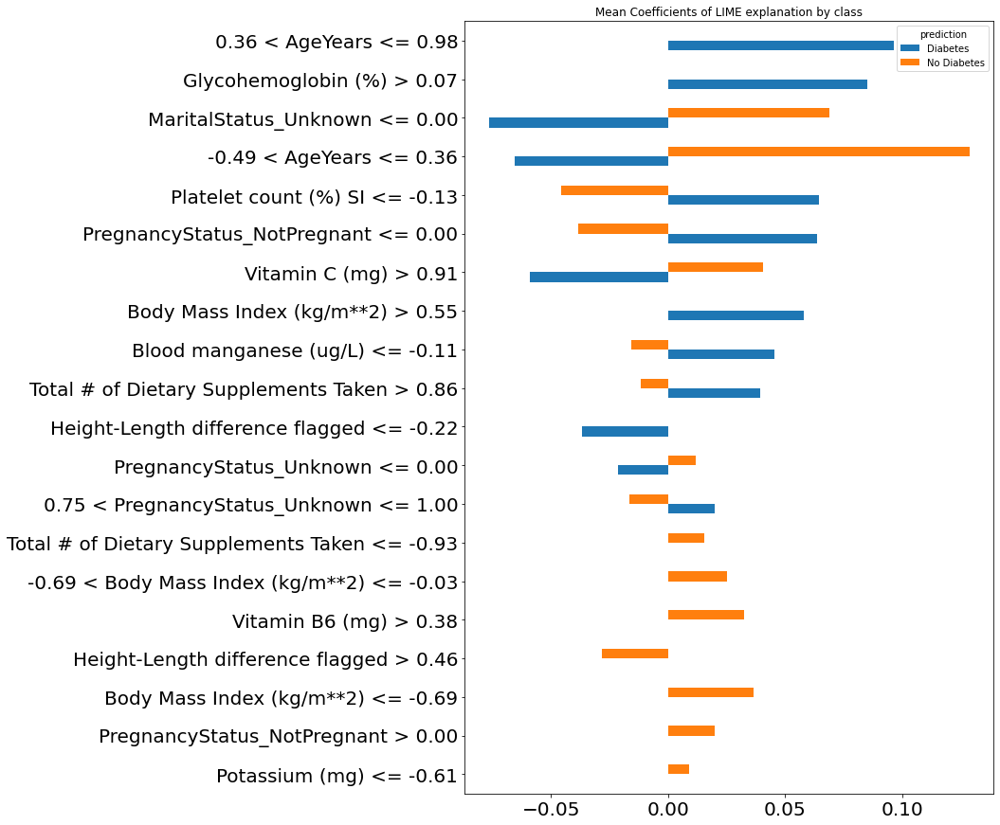

In [99]:
global_exp_lime (best_lsvc,X100)

##### Local explanation SHAP vs LIME

In [144]:
def local_exp_function(model, single_sample, sample_size):
    predict_fn_rf = lambda x: model.predict_proba(x).astype(float)
    X = sample_size.values
    explainer_lime = lime.lime_tabular.LimeTabularExplainer(X,feature_names = sample_size.columns,class_names=['No Diabetes','Diabetes'],kernel_width=5)

    choosen_instance = sample_size.reset_index(drop = True).loc[[single_sample]].values[0]
    exp = explainer_lime.explain_instance(choosen_instance, predict_fn_rf,num_features=10)
    exp.show_in_notebook(show_all=False)
    
    # additional plot for lime
    fig = exp.as_pyplot_figure()  
    plt.show()
    plt.close()
    try:
        explainer = shap.TreeExplainer(best_rf)
        shap_values = explainer.shap_values(sample_size)
    except:
        explainer = shap.Explainer(model, sample_size)
        shap_values = explainer.shap_values(sample_size)
    #print('Local force plot for single sample [SHAP]'
    try:
        fig2 = shap.plots._bar.bar_legacy(shap_values[single_sample], sample_size.iloc[single_sample],max_display = 10)
    except:
        fig2 = shap.plots._bar.bar_legacy(shap_values[1][single_sample], sample_size.iloc[single_sample],max_display = 10)
    return fig2
    #return (shap.force_plot(explainer.expected_value, shap_values[single_sample],sample_size.iloc[single_sample],link="logit", matplotlib = True ,  figsize = (40,3)))

9


X does not have valid feature names, but SVC was fitted with feature names


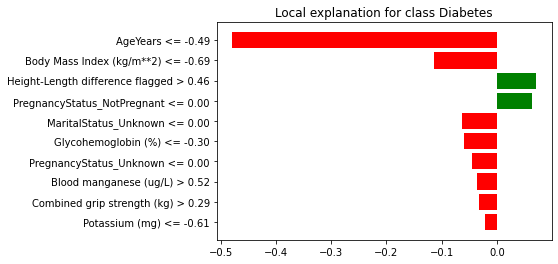

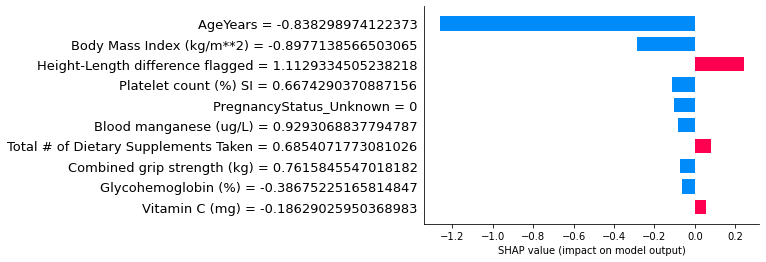

15


X does not have valid feature names, but SVC was fitted with feature names


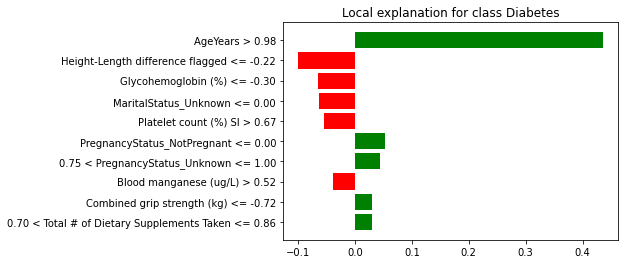

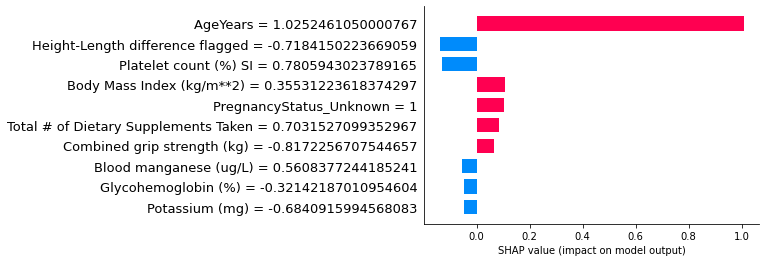

64


X does not have valid feature names, but SVC was fitted with feature names


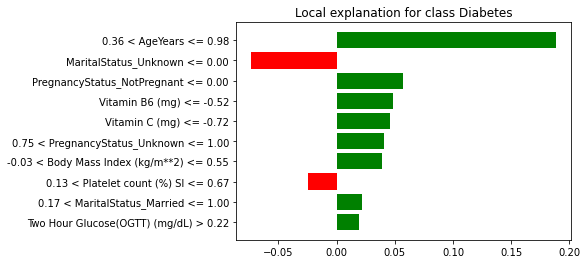

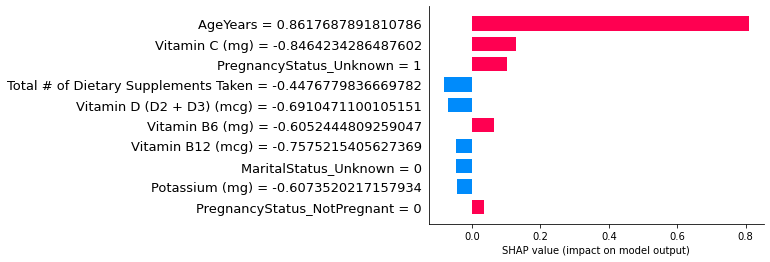

28


X does not have valid feature names, but SVC was fitted with feature names


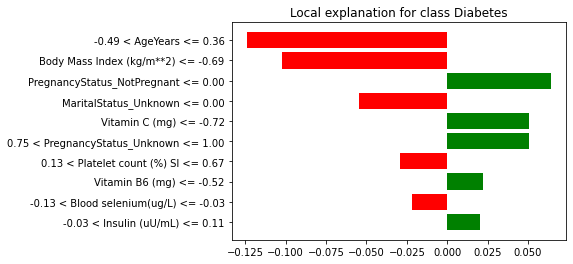

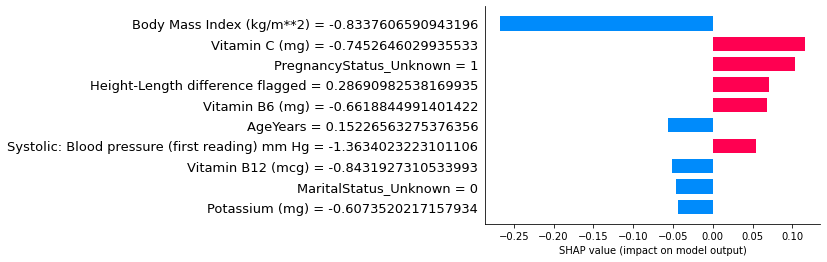

In [94]:
#X100.reset_index().loc[[0]]
np.random.seed(10)

"""explainer = shap.Explainer(best_lsvc, X100)
shap_values = explainer.shap_values(X100)
#shap.summary_plot(shap_values[0], X100)
#shap.plots._waterfall.waterfall_legacy(explainer.expected_value, shap_values[0], features =  X100.iloc[0,:])
shap.plots._bar.bar_legacy( shap_values[0], X100.iloc[0],max_display = 10)"""
local_list = list(np.random.randint(100, size=4))


for x in local_list:
    print(x)
    local_exp_function(best_lsvc,x,X100)


##### Permutation Feature Importance

In [86]:
perm_lsvc = PermutationImportance(best_lsvc, random_state = 42).fit(X_test, y_test)
eli5.show_weights(perm_lsvc, feature_names = feature_selected_cols)

Weight,Feature
0.2055 ± 0.0177,AgeYears
0.0091 ± 0.0076,Body Mass Index (kg/m**2)
0.0085 ± 0.0036,Glycohemoglobin (%)
0.0060 ± 0.0044,MaritalStatus_Unknown
0.0043 ± 0.0085,Platelet count (%) SI
0.0038 ± 0.0052,Combined grip strength (kg)
0.0022 ± 0.0029,Potassium (mg)
0.0021 ± 0.0027,Blood manganese (ug/L)
0.0016 ± 0.0032,PregnancyStatus_Unknown
0.0015 ± 0.0051,Total # of Dietary Supplements Taken


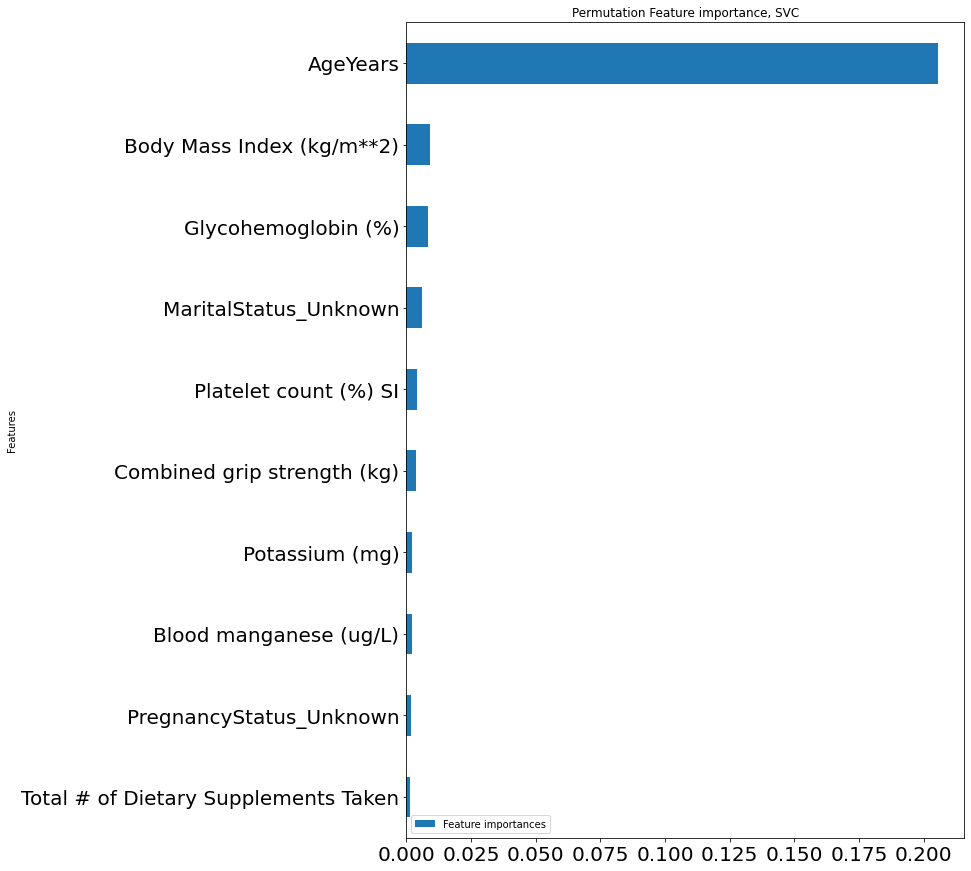

In [87]:
df_pfi_lsvc = pd.DataFrame({'Features': feature_selected_cols,
                          'Feature importances': perm_lsvc.feature_importances_, 
                          })
df_pfi_lsvc.sort_values('Feature importances', ascending=False).head(10).sort_values('Feature importances').plot(kind='barh',x='Features',y='Feature importances', figsize=(10,15),fontsize=20, title='Permutation Feature importance, SVC')
plt.show()

### Logistic Regression

Fitting 5 folds for each of 6 candidates, totalling 30 fits
---------------------------------------------------------
Best params: {'classifier__C': 0.01}
Train score:  0.8006543075245365
Test score:  0.7967479674796748
Test precission:  0.645618556701031
Test recall:  0.8697916666666666


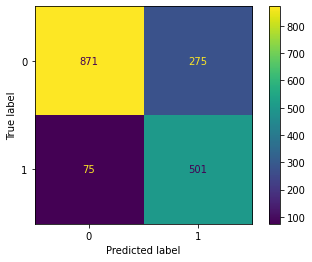

In [88]:
#Hyperparameter tuning
pipe = Pipeline([('classifier', LogisticRegression(penalty="l1", dual = False, solver='liblinear'))])

param_grid = [
    {   
        'classifier__C':[0.001, 0.01, 0.1,0.3, 0.5, 1]
    }
]

# Hyperparameter tuning and cross validation
search = GridSearchCV(pipe, param_grid, cv=5, n_jobs=8, verbose=3)


search.fit(X_train,np.ravel(y_train))

best_lr = search.best_estimator_[-1]

y_preds_lr = search.predict(X_test) 

print('---------------------------------------------------------')
print('Best params:', search.best_params_)
print("Train score: ", search.score(X_train,np.ravel(y_train)))
print("Test score: ", search.score(X_test,np.ravel(y_test)))
print("Test precission: ", precision_score(np.ravel(y_test), y_preds_lr))
print("Test recall: ", recall_score(np.ravel(y_test), y_preds_lr))


#Confusion Matrix display
cm_lr = confusion_matrix(y_test, y_preds_lr)

disp = ConfusionMatrixDisplay(confusion_matrix=cm_lr,
                              display_labels=[0,1])
disp.plot()

plt.show()



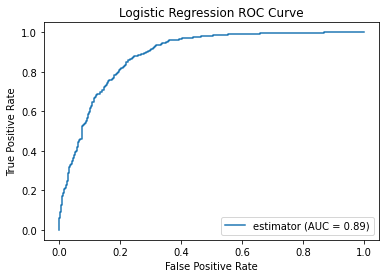

In [89]:
#ROC Curve

lr_probas_ = best_lr.predict_proba(X_test)
fpr, tpr, thresholds = metrics.roc_curve(y_test, lr_probas_[:, 1])
roc_auc = metrics.auc(fpr, tpr)
display = metrics.RocCurveDisplay(fpr=fpr, tpr=tpr, roc_auc=roc_auc,
                                  estimator_name='estimator')
display.plot()
plt.title("Logistic Regression ROC Curve")

plt.show()

#### Model explanation

##### Default feature importance

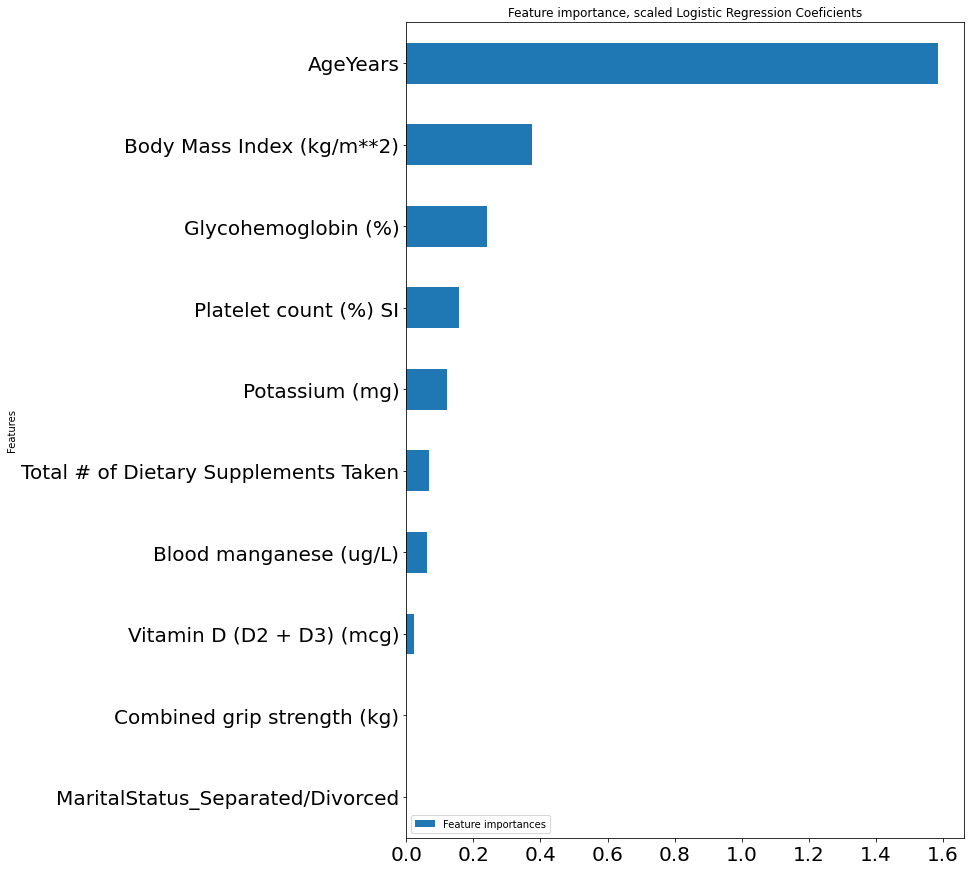

In [90]:
#Features used
feature_imp = abs(best_lr.coef_[0])

importance_index_lr = np.nonzero(feature_imp)[0]

feature_importance = pd.DataFrame({'Features':feature_selected_cols ,'Feature importances':feature_imp})
feature_importance.sort_values(by='Feature importances', ascending=False).head(10).sort_values(by='Feature importances').plot(kind='barh',x='Features',y='Feature importances', figsize=(10,15),fontsize=20, title='Feature importance, scaled Logistic Regression Coeficients')
plt.show()

##### SHAP

Global explanation

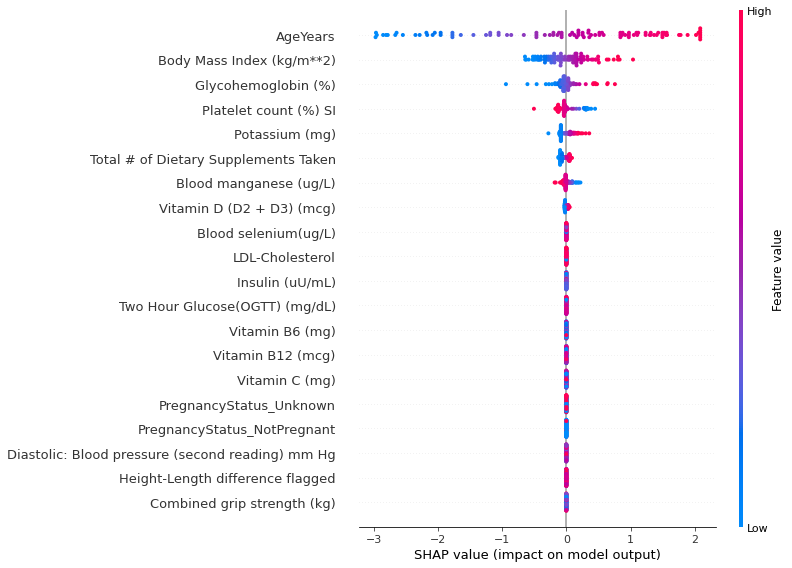

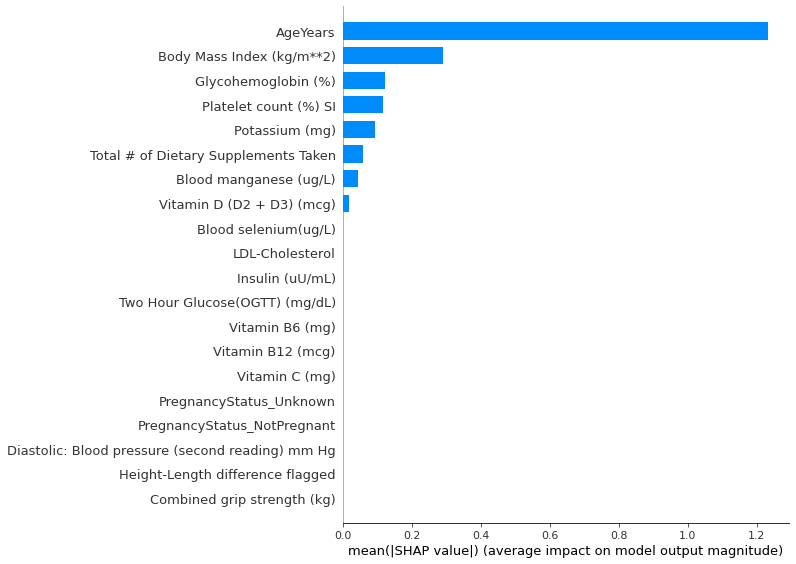

Local force plot for single sample


In [91]:
### SHAP
# Fit shap with sample of 100. Can change to 1 to visualize local data

sample_num_to_explain = 100 # How many sample points to include
class_to_explain = 1 # Explain with respect to which predictive label
single_sample_num = 0 # When plotting local explanation, which sample num

X100 = shap.utils.sample(X_train, sample_num_to_explain) # Sample to use as background distribution
explainer = shap.Explainer(best_lr, X100)
shap_values = explainer.shap_values(X100)

# Shap values that explain predictions on class 1  shap_values[class]
shap.summary_plot(shap_values, X100)
shap.summary_plot(shap_values, X100, plot_type="bar")

print('Local force plot for single sample')
shap.force_plot(explainer.expected_value, shap_values[single_sample_num],X100.iloc[single_sample_num] )



##### LIME

X does not have valid feature names, but LogisticRegression was fitted with feature names
X does not have valid feature names, but LogisticRegression was fitted with feature names
X does not have valid feature names, but LogisticRegression was fitted with feature names
X does not have valid feature names, but LogisticRegression was fitted with feature names
X does not have valid feature names, but LogisticRegression was fitted with feature names


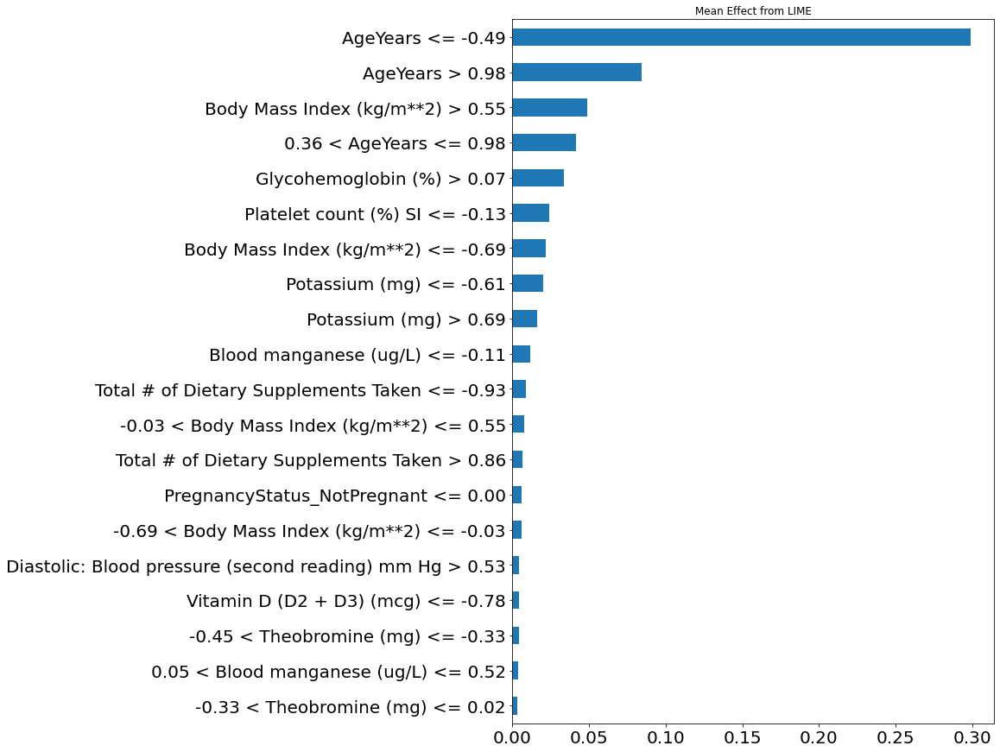

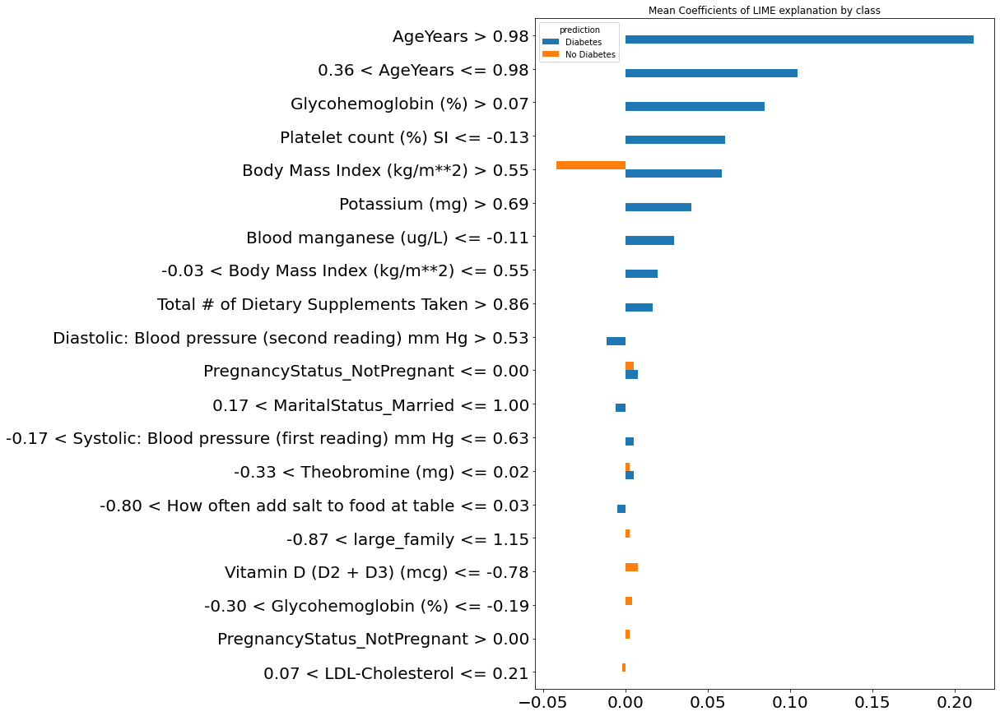

In [100]:
global_exp_lime (best_lr,X100)

##### Local explanation SHAP vs LIME

X does not have valid feature names, but LogisticRegression was fitted with feature names


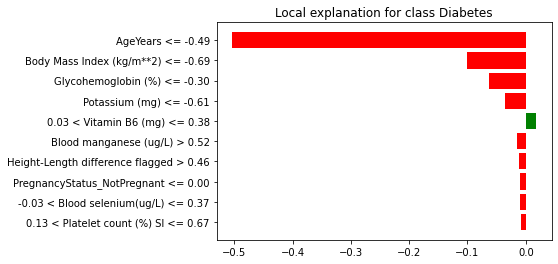

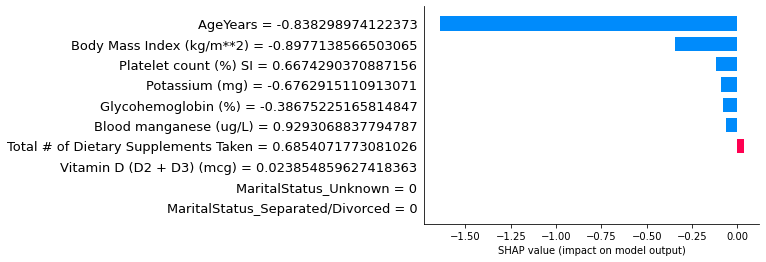

X does not have valid feature names, but LogisticRegression was fitted with feature names


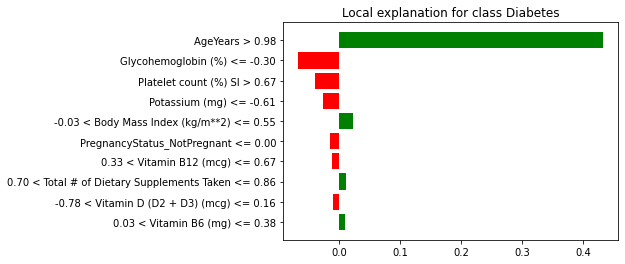

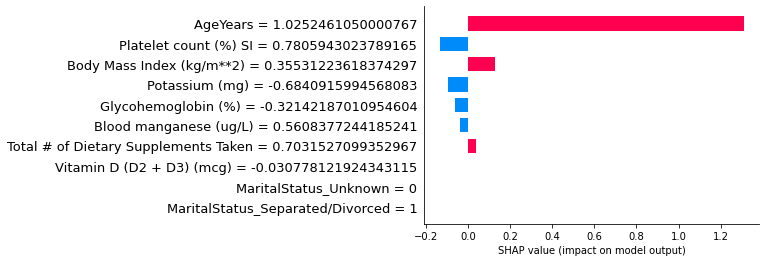

X does not have valid feature names, but LogisticRegression was fitted with feature names


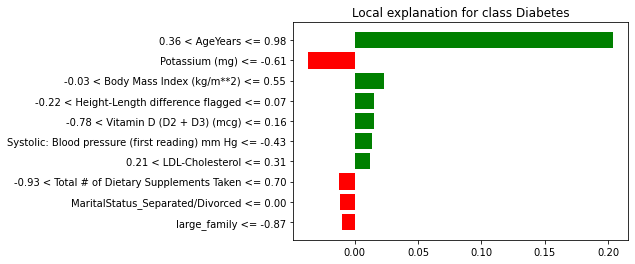

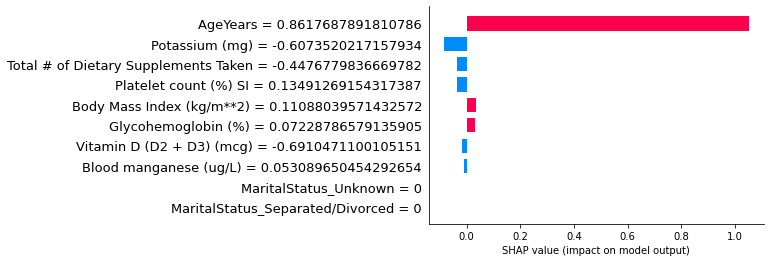

X does not have valid feature names, but LogisticRegression was fitted with feature names


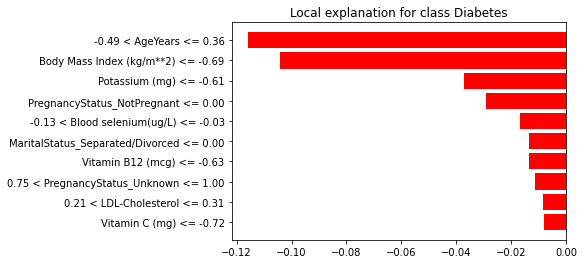

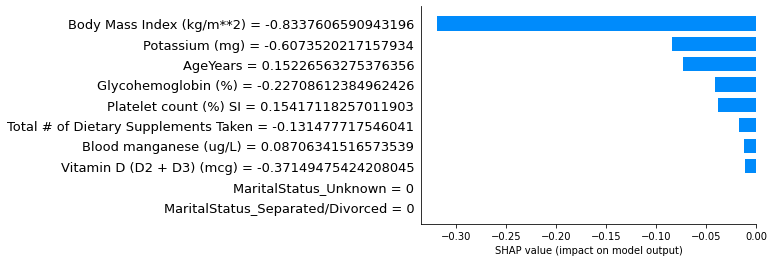

In [95]:
for x in local_list:
    local_exp_function(best_lr,x,X100)

##### Permutation Feature Importance

In [101]:
perm_lr = PermutationImportance(best_lr, random_state = 42).fit(X_test, y_test)
eli5.show_weights(perm_lr, feature_names = feature_selected_cols)

Weight,Feature
0.2190 ± 0.0172,AgeYears
0.0128 ± 0.0083,Body Mass Index (kg/m**2)
0.0071 ± 0.0051,Platelet count (%) SI
0.0065 ± 0.0041,Glycohemoglobin (%)
0.0058 ± 0.0023,Potassium (mg)
0.0010 ± 0.0044,Total # of Dietary Supplements Taken
0.0001 ± 0.0020,Vitamin D (D2 + D3) (mcg)
0 ± 0.0000,MaritalStatus_Unknown
0 ± 0.0000,Insulin (uU/mL)
0 ± 0.0000,Two Hour Glucose(OGTT) (mg/dL)


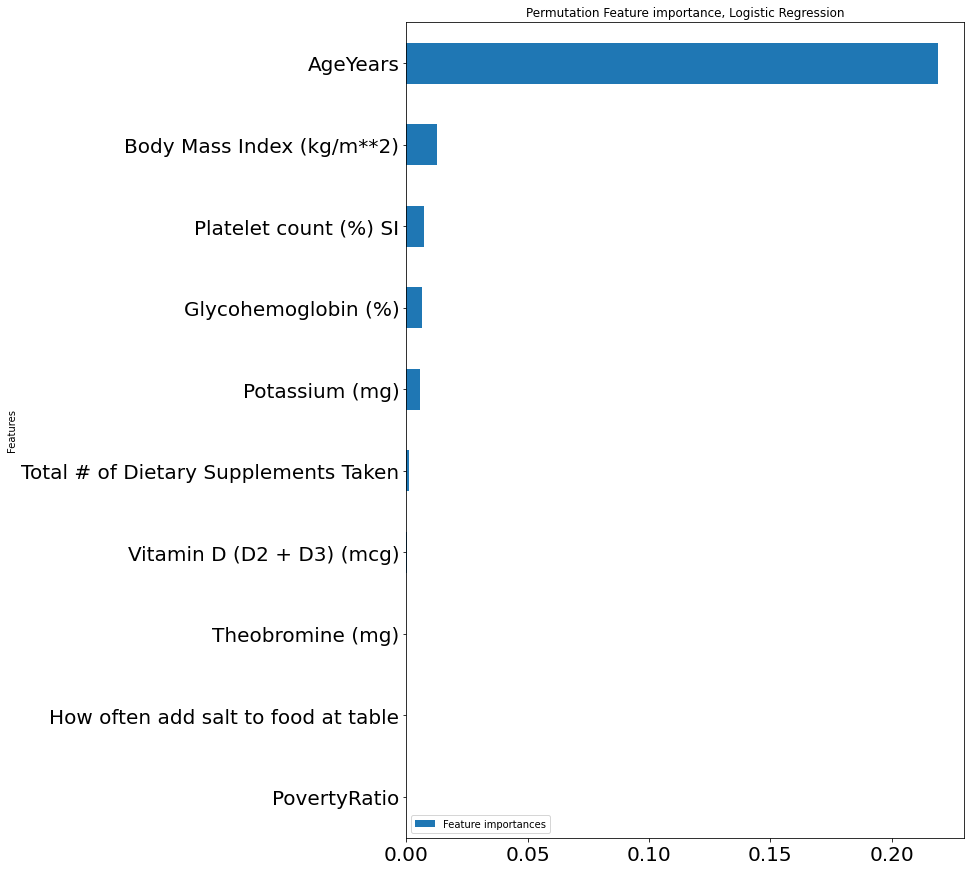

In [102]:
df_pfi_lr = pd.DataFrame({'Features': feature_selected_cols,
                          'Feature importances': perm_lr.feature_importances_, 
                          })
df_pfi_lr.sort_values('Feature importances', ascending=False).head(10).sort_values('Feature importances').plot(kind='barh',x='Features',y='Feature importances', figsize=(10,15),fontsize=20, title='Permutation Feature importance, Logistic Regression')
plt.show()

### Decision Tree

Fitting 5 folds for each of 56 candidates, totalling 280 fits
---------------------------------------------------------
Best params: {'classifier__criterion': 'gini', 'classifier__max_depth': 11}
Train score:  0.9162486368593239
Test score:  0.8060394889663183
Test precission:  0.6816816816816816
Test recall:  0.7881944444444444


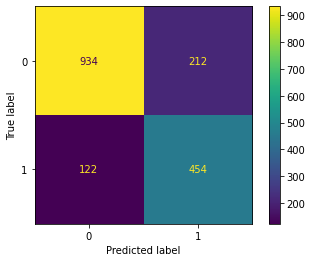

In [103]:
#Hyperparameter tuning
pipe = Pipeline([('classifier', DecisionTreeClassifier(random_state = 42))])

param_grid = [
    {   
        'classifier__max_depth':list(range(2, 30)),
        'classifier__criterion': ['gini','entropy']
    }
]

# Hyperparameter tuning and cross validation
search = GridSearchCV(pipe, param_grid, cv=5, n_jobs=8, verbose=3)


search.fit(X_train,np.ravel(y_train))
best_dtc = search.best_estimator_[-1]

y_preds_dtc = search.predict(X_test) 

print('---------------------------------------------------------')
print('Best params:', search.best_params_)
print("Train score: ", search.score(X_train,np.ravel(y_train)))
print("Test score: ", search.score(X_test,np.ravel(y_test)))
print("Test precission: ", precision_score(np.ravel(y_test), y_preds_dtc))
print("Test recall: ", recall_score(np.ravel(y_test), y_preds_dtc))


#Confusion Matrix display
cm_dtc = confusion_matrix(y_test, y_preds_dtc)

disp = ConfusionMatrixDisplay(confusion_matrix=cm_dtc,
                              display_labels=[0,1])
disp.plot()

plt.show()



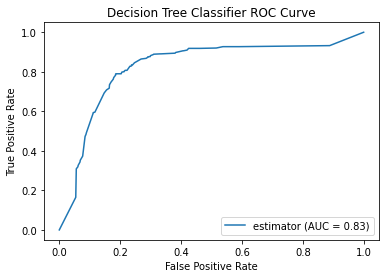

In [104]:
#ROC Curve

dtc_probas_ = best_dtc.predict_proba(X_test)
fpr, tpr, thresholds = metrics.roc_curve(y_test, dtc_probas_[:, 1])
roc_auc = metrics.auc(fpr, tpr)
display = metrics.RocCurveDisplay(fpr=fpr, tpr=tpr, roc_auc=roc_auc,
                                  estimator_name='estimator')
display.plot()

plt.title("Decision Tree Classifier ROC Curve")

plt.show()

#### Model explanation

##### Tree visualization

[Text(0.362963076545633, 0.9583333333333334, 'AgeYears <= 0.071\ngini = 0.5\nsamples = 100.0%\nvalue = [0.5, 0.5]\nclass = ['),
 Text(0.13478287536800784, 0.875, 'AgeYears <= -0.425\ngini = 0.234\nsamples = 39.2%\nvalue = [0.864, 0.136]\nclass = ['),
 Text(0.0978900883218842, 0.7916666666666666, 'Glycohemoglobin (%) <= 2.777\ngini = 0.093\nsamples = 27.5%\nvalue = [0.951, 0.049]\nclass = ['),
 Text(0.08390578999018646, 0.7083333333333334, 'Body Mass Index (kg/m**2) <= 2.792\ngini = 0.087\nsamples = 27.4%\nvalue = [0.955, 0.045]\nclass = ['),
 Text(0.06182531894013739, 0.625, 'Body Mass Index (kg/m**2) <= -0.213\ngini = 0.077\nsamples = 27.1%\nvalue = [0.96, 0.04]\nclass = ['),
 Text(0.035819430814524045, 0.5416666666666666, 'Height-Length difference flagged <= 1.414\ngini = 0.036\nsamples = 19.7%\nvalue = [0.982, 0.018]\nclass = ['),
 Text(0.027968596663395486, 0.4583333333333333, 'Blood selenium(ug/L) <= 0.534\ngini = 0.032\nsamples = 19.5%\nvalue = [0.984, 0.016]\nclass = ['),
 Text(

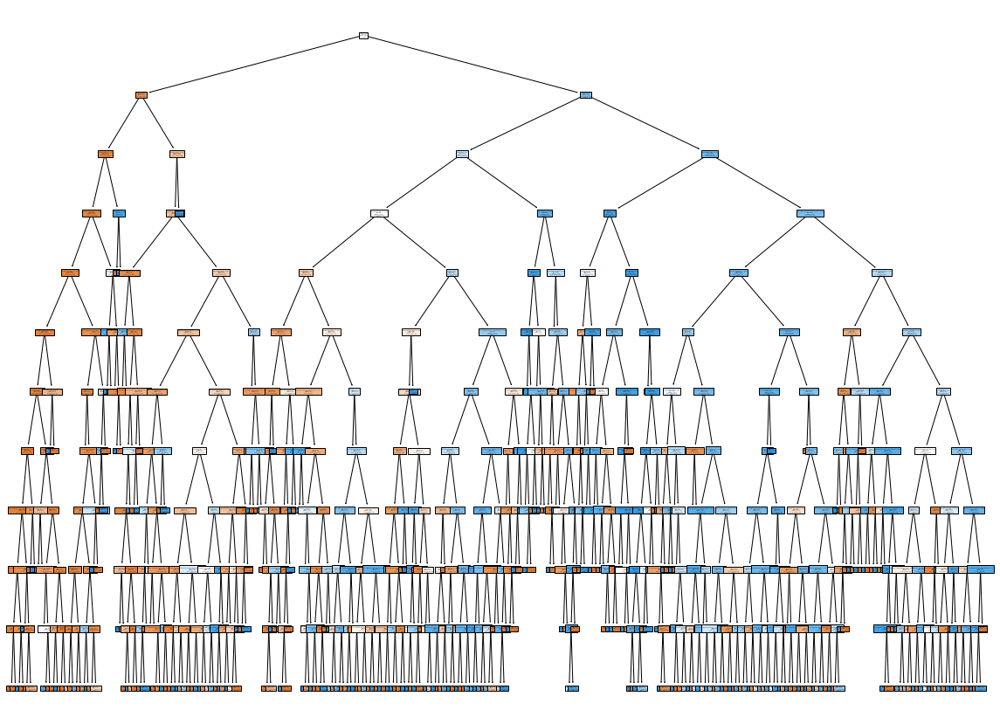

In [105]:
# #Plot Tree
from sklearn import tree
plt.figure(figsize = (20,15))
plot_tree(best_dtc, feature_names= feature_selected_cols, class_names= str(y_train.unique()), filled=True, proportion=True)


##### Default feature importance

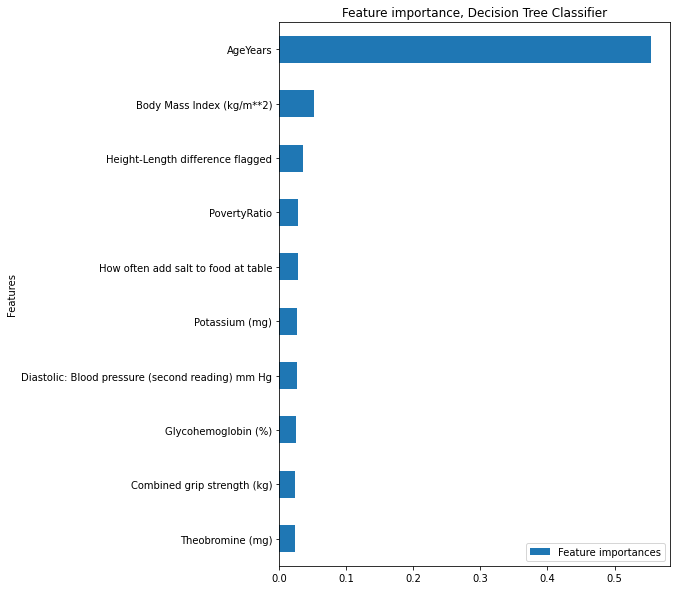

In [106]:
#Features used
feature_imp = best_dtc.feature_importances_

importance_index_dtc = np.nonzero(feature_imp)[0]

feature_importance = pd.DataFrame({'Features':feature_selected_cols ,'Feature importances':feature_imp})
feature_importance.sort_values(by='Feature importances', ascending=False).head(10).sort_values(by = 'Feature importances').plot(kind='barh',x='Features',y='Feature importances', figsize=(7,10), title='Feature importance, Decision Tree Classifier')
plt.show()

##### SHAP

Global explanation

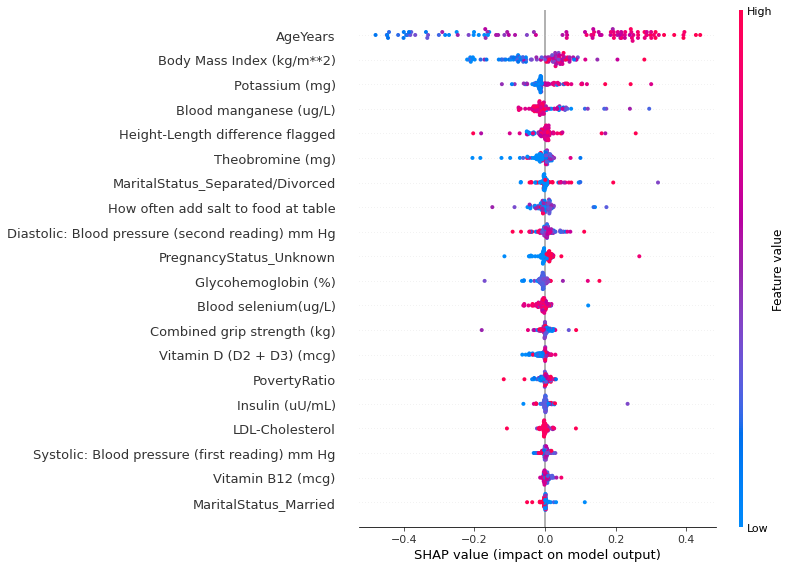

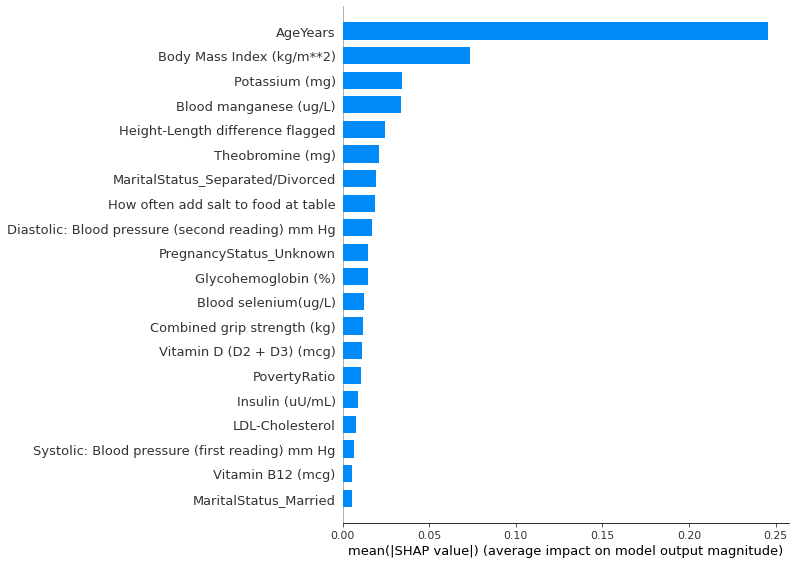

Local force plot for single sample


In [114]:
### SHAP
# Fit shap with sample of 100. Can change to 1 to visualize local data

sample_num_to_explain = 100 # How many sample points to include
class_to_explain = 1 # Explain with respect to which predictive label
single_sample_num = 0 # When plotting local explanation, which sample num

X100 = shap.utils.sample(X_train, sample_num_to_explain) # Sample to use as background distribution
explainer = shap.TreeExplainer(best_dtc)
shap_values = explainer.shap_values(X100)

# Shap values that explain predictions on class 1  shap_values[class]
shap.summary_plot(shap_values[1], X100)
shap.summary_plot(shap_values[1], X100, plot_type="bar")

print('Local force plot for single sample')
shap.force_plot(explainer.expected_value[1], shap_values[1][single_sample_num],X100.iloc[single_sample_num] )



##### LIME

X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names


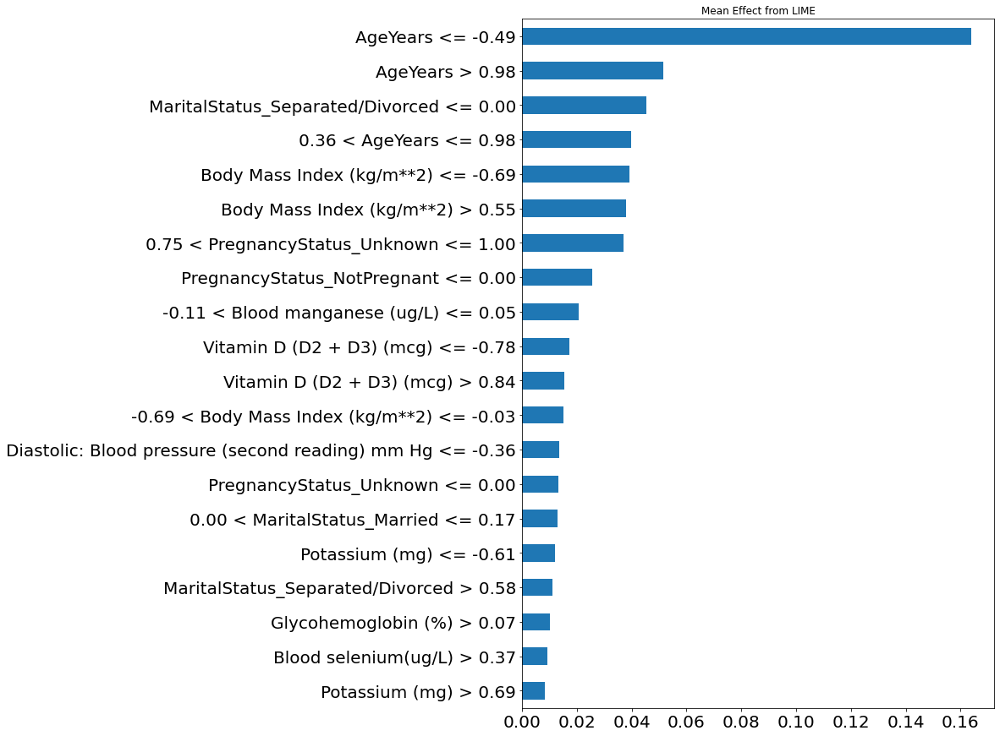

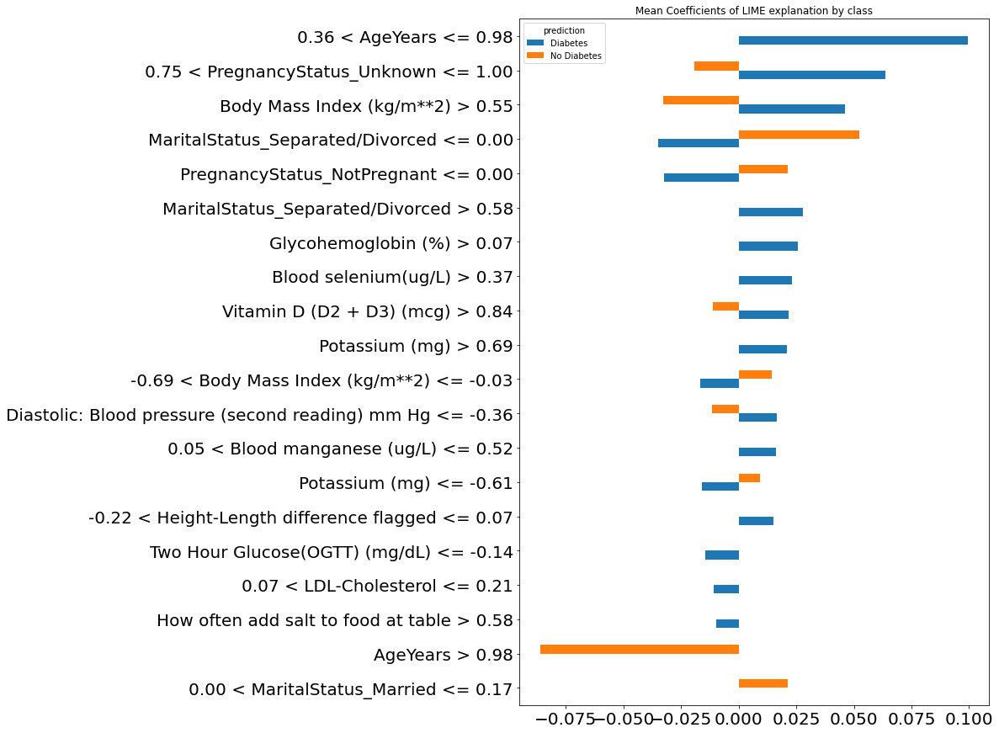

In [130]:
global_exp_lime (best_dtc,X100)

##### Local explanation SHAP vs LIME

9


X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names


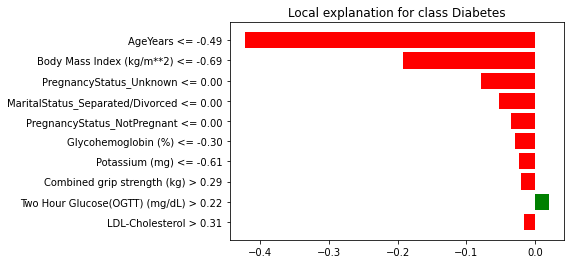

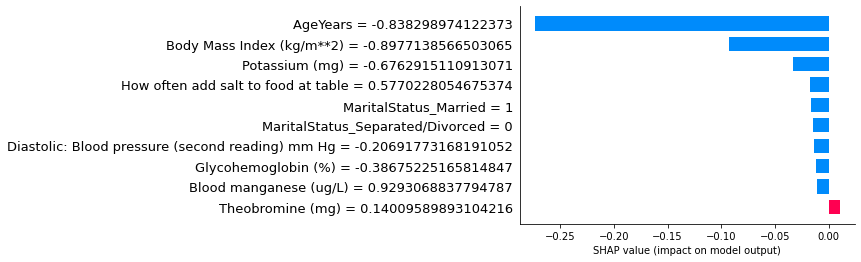

15


X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names


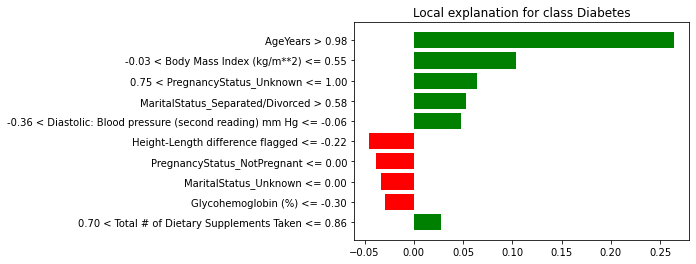

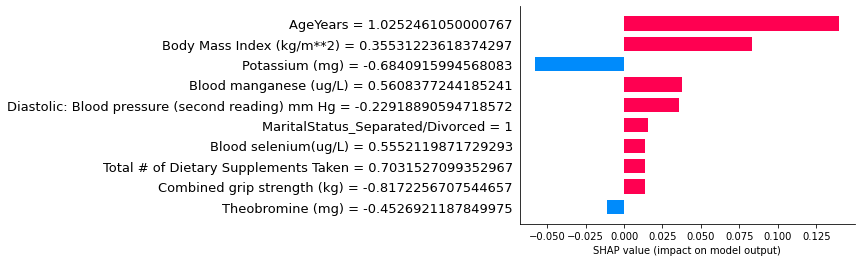

64


X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names


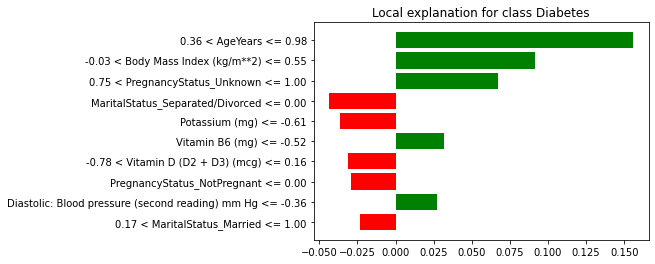

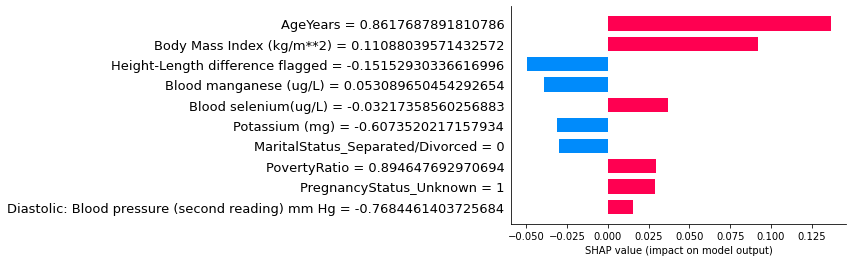

28


X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names


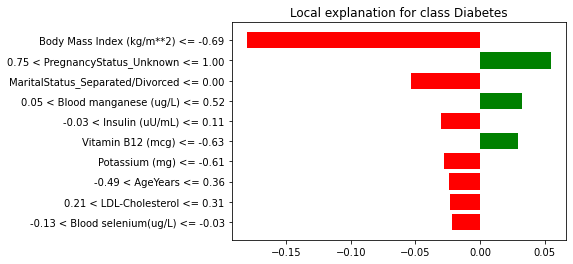

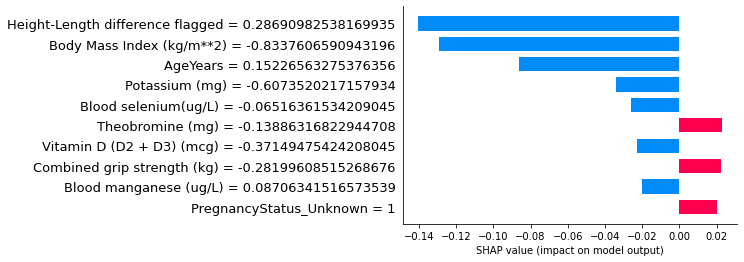

In [129]:
for x in local_list:
    print(x)
    local_exp_function(best_dtc,x,X100)



##### Permutation Feature Importance

In [131]:
perm_dtc = PermutationImportance(best_dtc, random_state = 42).fit(X_test, y_test)
eli5.show_weights(perm_dtc, feature_names = feature_selected_cols)

Weight,Feature
0.1999 ± 0.0109,AgeYears
0.0792 ± 0.0124,Body Mass Index (kg/m**2)
0.0244 ± 0.0043,PregnancyStatus_Unknown
0.0231 ± 0.0024,Blood selenium(ug/L)
0.0214 ± 0.0038,Potassium (mg)
0.0139 ± 0.0076,Height-Length difference flagged
0.0128 ± 0.0080,Blood manganese (ug/L)
0.0123 ± 0.0103,How often add salt to food at table
0.0117 ± 0.0044,Diastolic: Blood pressure (second reading) mm Hg
0.0109 ± 0.0049,Glycohemoglobin (%)


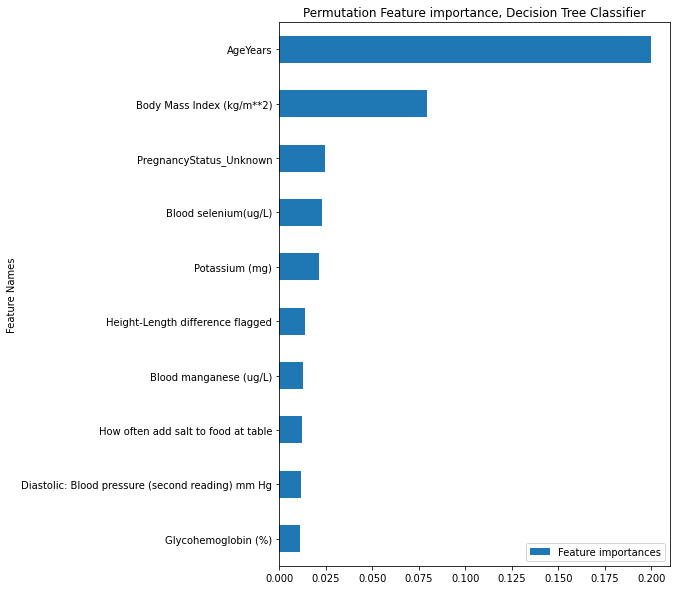

In [132]:
df_pfi_dtc = pd.DataFrame({'Feature Names': feature_selected_cols,
                          'Feature importances': perm_dtc.feature_importances_, 
                          })
df_pfi_dtc.sort_values('Feature importances', ascending=False).head(10).sort_values('Feature importances').plot(kind='barh',x='Feature Names',y='Feature importances', figsize=(7,10), title='Permutation Feature importance, Decision Tree Classifier')
plt.show()

### RandomForestClassifier

Fitting 5 folds for each of 9 candidates, totalling 45 fits
---------------------------------------------------------
Best params: {'classifier__max_depth': 12, 'classifier__n_estimators': 1000}
Train score:  0.9378407851690295
Test score:  0.8205574912891986
Test precission:  0.6904422253922967
Test recall:  0.8402777777777778


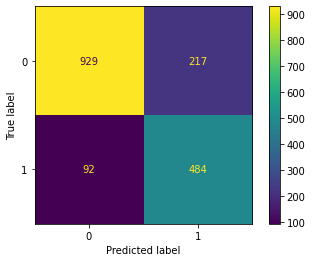

In [133]:
#Hyperparameter tuning
pipe = Pipeline([('classifier', RandomForestClassifier(random_state = 42))])

param_grid = [
    {   
        'classifier__max_depth':list(range(2, 17, 5)),
        'classifier__n_estimators': [800, 1000, 1500],
        # 'classifier__criterion': ['gini','entropy']
    }
]

# Hyperparameter tuning and cross validation
search = GridSearchCV(pipe, param_grid, cv=5, n_jobs=8, verbose=3)


search.fit(X_train,np.ravel(y_train))
best_rf = search.best_estimator_[-1]

y_preds_rf = search.predict(X_test) 

print('---------------------------------------------------------')
print('Best params:', search.best_params_)
print("Train score: ", search.score(X_train,np.ravel(y_train)))
print("Test score: ", search.score(X_test,np.ravel(y_test)))
print("Test precission: ", precision_score(np.ravel(y_test), y_preds_rf))
print("Test recall: ", recall_score(np.ravel(y_test), y_preds_rf))


#Confusion Matrix display
cm_rf = confusion_matrix(y_test, y_preds_rf)

disp = ConfusionMatrixDisplay(confusion_matrix=cm_rf,
                              display_labels=[0,1])
disp.plot()

plt.show()



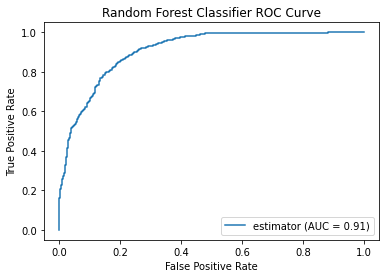

In [134]:
#ROC Curve

rf_probas_ = best_rf.predict_proba(X_test)
fpr, tpr, thresholds = metrics.roc_curve(y_test, rf_probas_[:, 1])
roc_auc = metrics.auc(fpr, tpr)
display = metrics.RocCurveDisplay(fpr=fpr, tpr=tpr, roc_auc=roc_auc,
                                  estimator_name='estimator')
display.plot()

plt.title("Random Forest Classifier ROC Curve")

plt.show()

#### Model explanation

##### Default feature importance

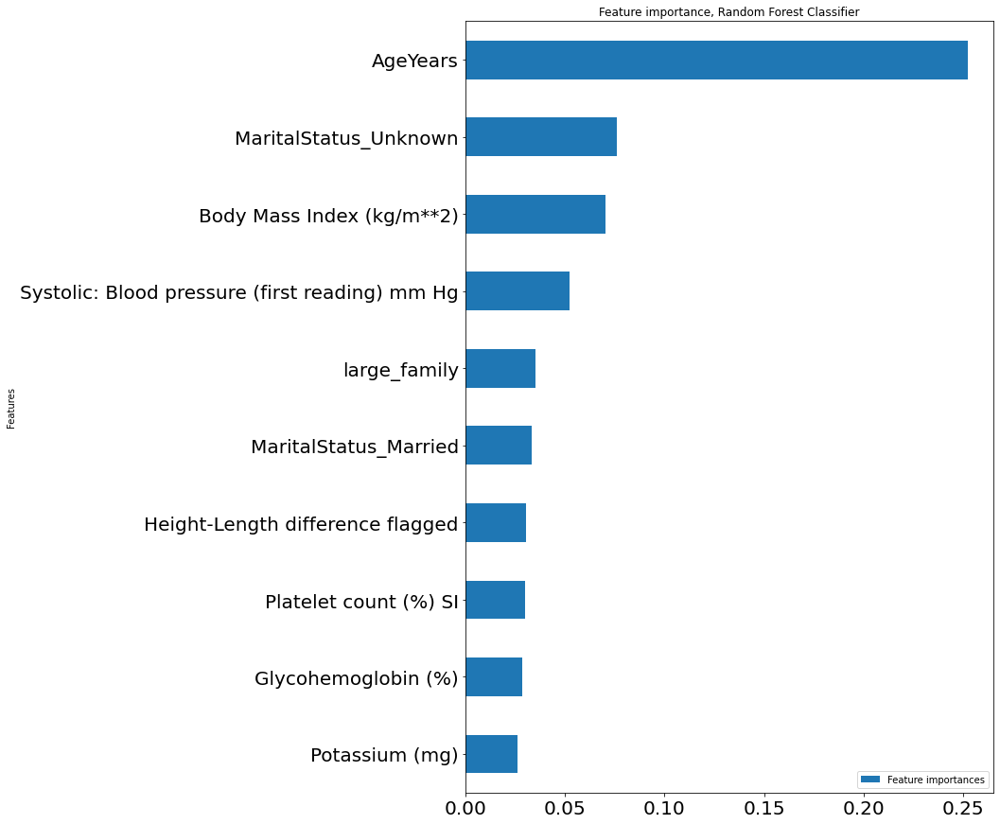

In [135]:
#Features used
feature_imp = best_rf.feature_importances_

importance_index_rf = np.nonzero(feature_imp)[0]

feature_importance = pd.DataFrame({'Features':feature_selected_cols ,'Feature importances':feature_imp})
feature_importance.sort_values(by='Feature importances', ascending=False).head(10).sort_values(by = 'Feature importances').plot(kind='barh',x='Features',y='Feature importances', figsize=(10,15),fontsize=20, title='Feature importance, Random Forest Classifier')
plt.show()

##### SHAP

Global explanation

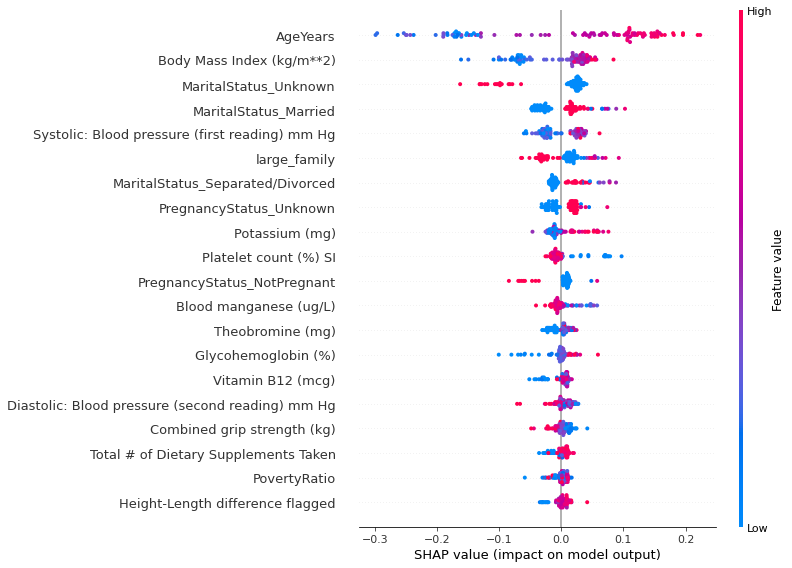

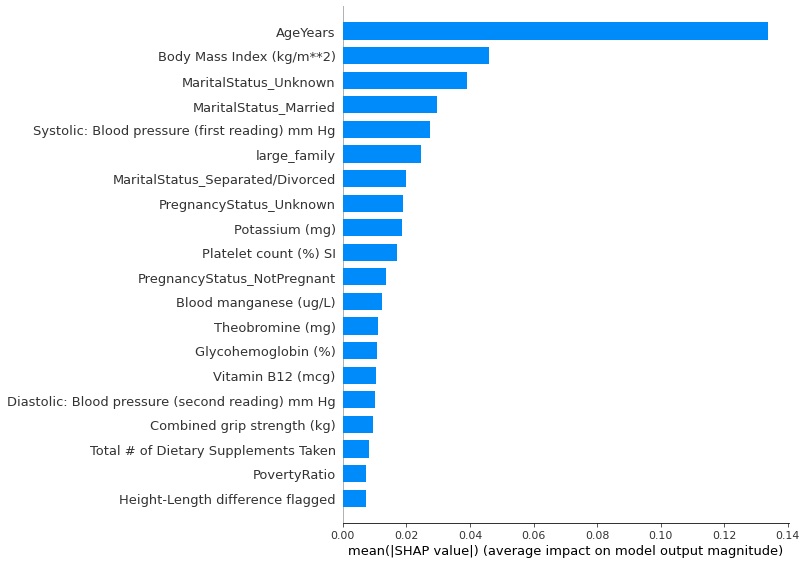

Local force plot for single sample


In [136]:
### SHAP
# Fit shap with sample of 100. Can change to 1 to visualize local data

sample_num_to_explain = 100 # How many sample points to include
class_to_explain = 1 # Explain with respect to which predictive label
single_sample_num = 0 # When plotting local explanation, which sample num

X100 = shap.utils.sample(X_train, sample_num_to_explain) # Sample to use as background distribution
explainer = shap.TreeExplainer(best_rf)
shap_values = explainer.shap_values(X100)

# Shap values that explain predictions on class 1  shap_values[class]
shap.summary_plot(shap_values[1], X100)
shap.summary_plot(shap_values[1], X100, plot_type="bar")

print('Local force plot for single sample')
shap.force_plot(explainer.expected_value[1], shap_values[1][single_sample_num],X100.iloc[single_sample_num] )



##### LIME

X does not have valid feature names, but RandomForestClassifier was fitted with feature names
X does not have valid feature names, but RandomForestClassifier was fitted with feature names
X does not have valid feature names, but RandomForestClassifier was fitted with feature names
X does not have valid feature names, but RandomForestClassifier was fitted with feature names
X does not have valid feature names, but RandomForestClassifier was fitted with feature names


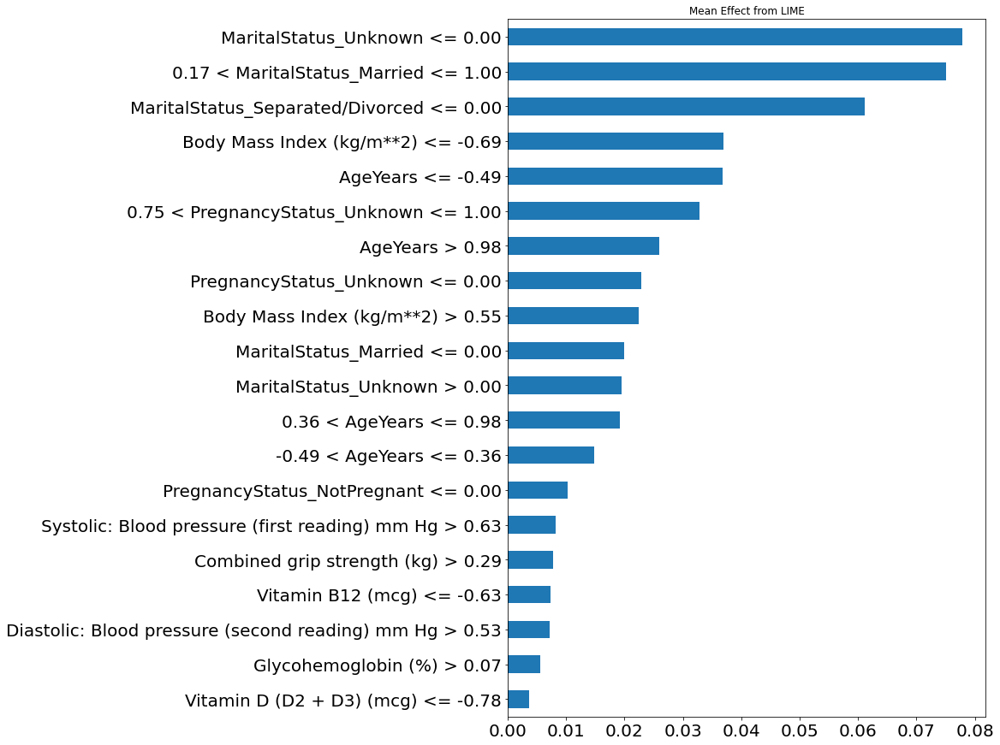

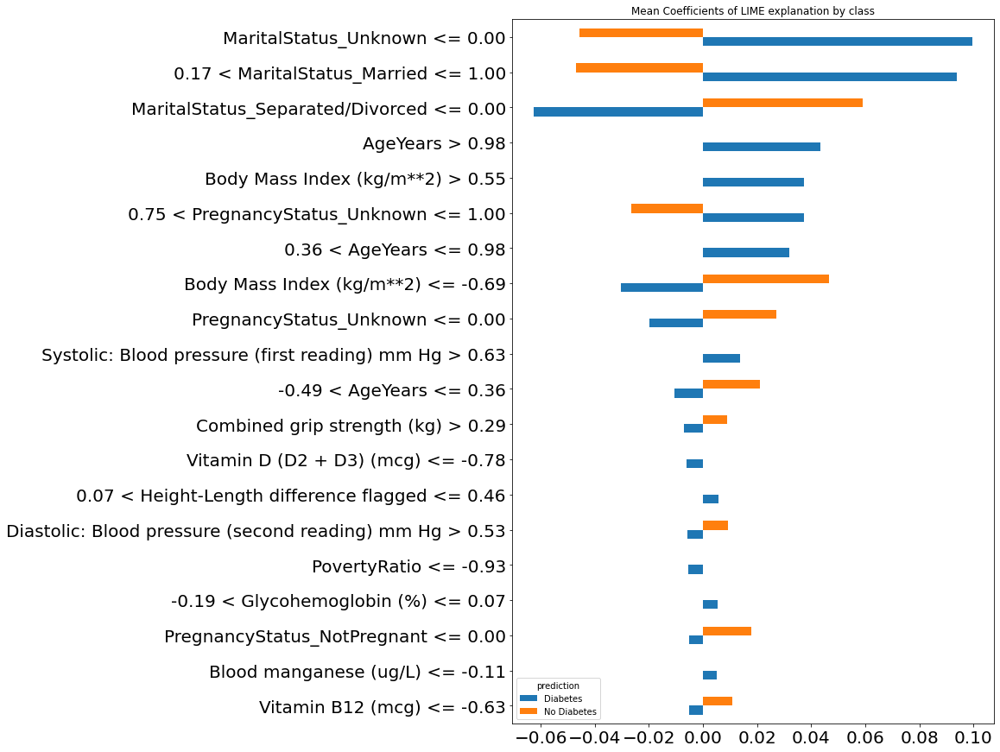

In [146]:

global_exp_lime (best_rf,X100)

##### Local explanation SHAP vs LIME

9


X does not have valid feature names, but RandomForestClassifier was fitted with feature names


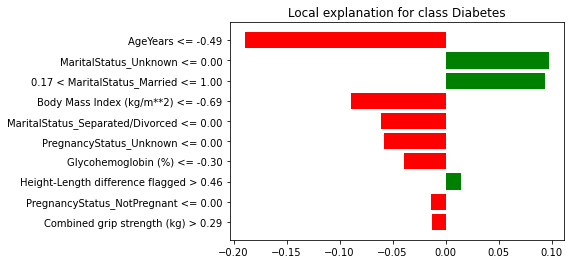

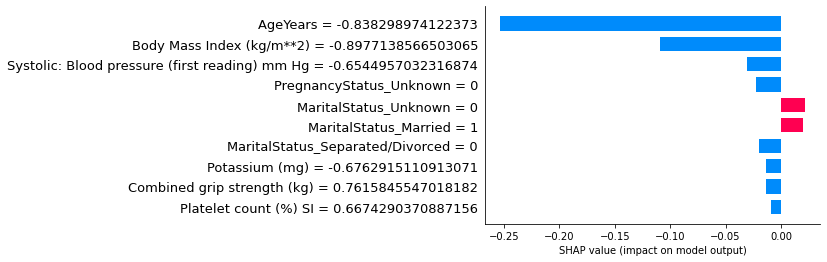

15


X does not have valid feature names, but RandomForestClassifier was fitted with feature names


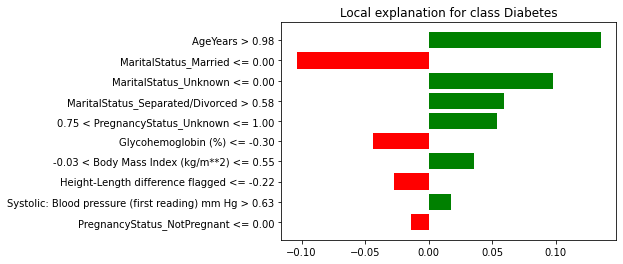

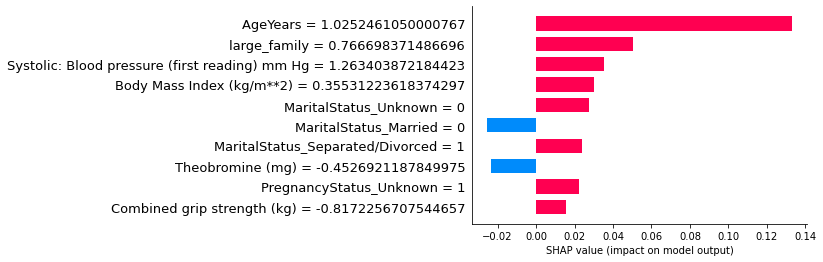

64


X does not have valid feature names, but RandomForestClassifier was fitted with feature names


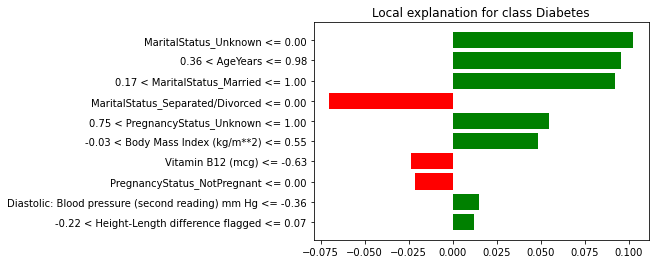

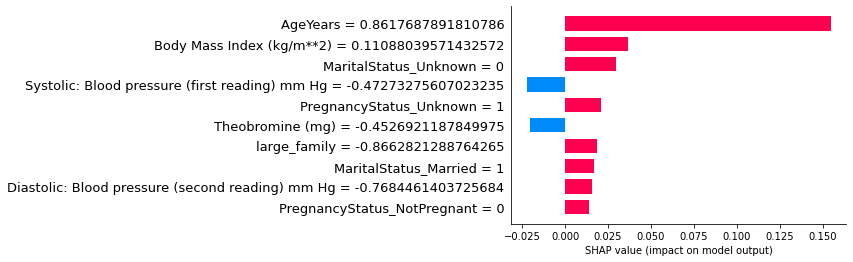

28


X does not have valid feature names, but RandomForestClassifier was fitted with feature names


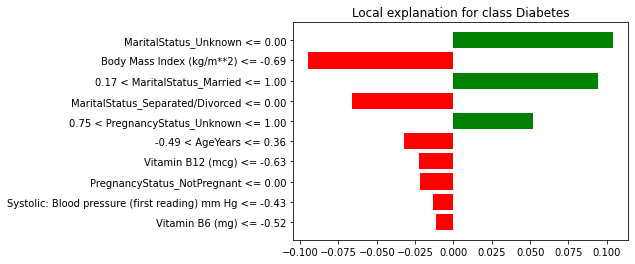

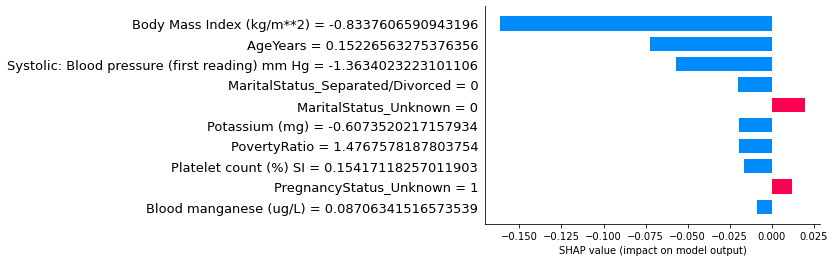

In [145]:
for x in local_list:
    print(x)
    local_exp_function(best_rf,x,X100)


##### Permutation Feature Importance

In [147]:
perm_rf = PermutationImportance(best_rf, random_state = 42).fit(X_test, y_test)
eli5.show_weights(perm_rf, feature_names = feature_selected_cols)

Weight,Feature
0.0965 ± 0.0089,AgeYears
0.0196 ± 0.0108,Body Mass Index (kg/m**2)
0.0060 ± 0.0054,Diastolic: Blood pressure (second reading) mm Hg
0.0038 ± 0.0016,MaritalStatus_Separated/Divorced
0.0038 ± 0.0020,Insulin (uU/mL)
0.0034 ± 0.0058,PovertyRatio
0.0030 ± 0.0024,Glycohemoglobin (%)
0.0028 ± 0.0023,Platelet count (%) SI
0.0027 ± 0.0032,How often add salt to food at table
0.0022 ± 0.0041,Combined grip strength (kg)


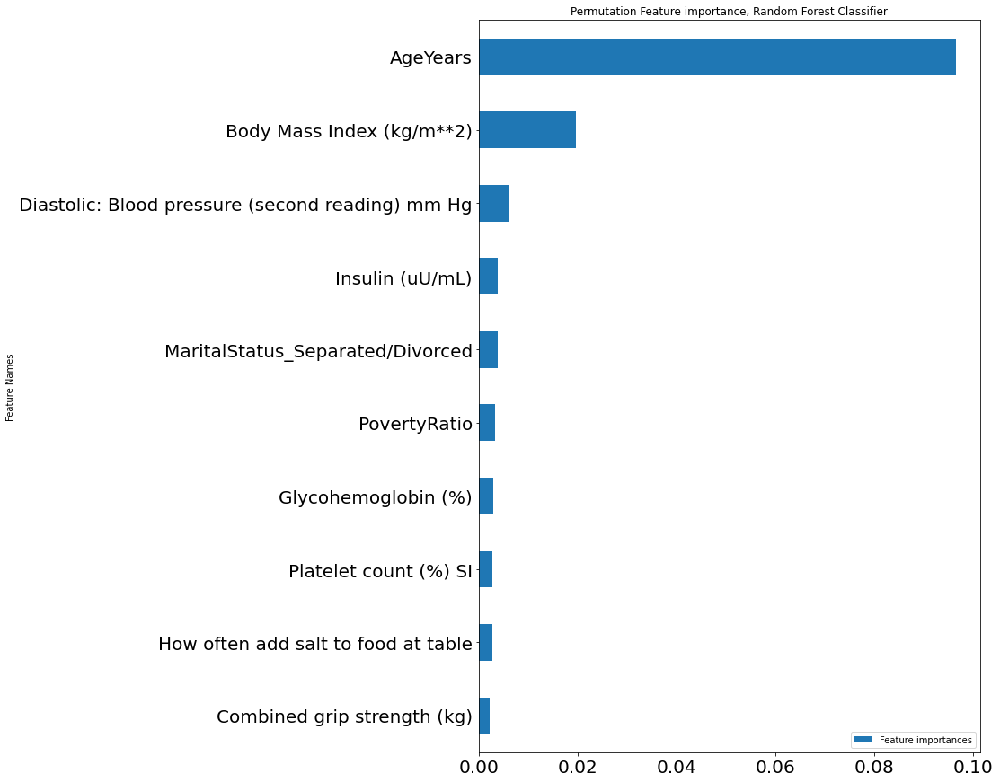

In [148]:
df_pfi_rf = pd.DataFrame({'Feature Names': feature_selected_cols,
                          'Feature importances': perm_rf.feature_importances_, 
                          })
df_pfi_rf.sort_values('Feature importances', ascending=False).head(10).sort_values('Feature importances').plot(kind='barh',x='Feature Names',y='Feature importances', figsize=(10,15),fontsize=20, title='Permutation Feature importance, Random Forest Classifier')
plt.show()

### LGBoost

Fitting 2 folds for each of 18 candidates, totalling 36 fits
---------------------------------------------------------
Best params: {'classifier__colsample_bytree': 1, 'classifier__max_depth': 6, 'classifier__n_estimators': 500}
Train score:  0.9998909487459106
Test score:  0.8495934959349594
Test precission:  0.7795414462081128
Test recall:  0.7673611111111112


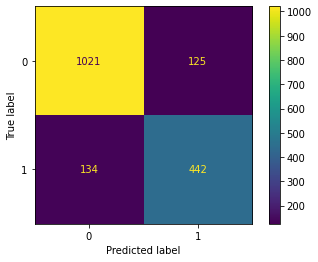

In [149]:
#Hyperparameter tuning
pipe = Pipeline([('classifier', lgb.LGBMClassifier(random_state = 42))])

param_grid = [
    {   
        "classifier__n_estimators": [500, 850, 1000],
        "classifier__max_depth": [3, 6, 9],
        'classifier__colsample_bytree': [0.8,1]
    }
]

# Hyperparameter tuning and cross validation
search = GridSearchCV(pipe, param_grid, cv=2, n_jobs=8, verbose=3)

search.fit(X_train.values,np.ravel(y_train))
best_lgbm = search.best_estimator_[-1]

y_preds_lgbm = search.predict(X_test) 

print('---------------------------------------------------------')
print('Best params:', search.best_params_)
print("Train score: ", search.score(X_train,np.ravel(y_train)))
print("Test score: ", search.score(X_test,np.ravel(y_test)))
print("Test precission: ", precision_score(np.ravel(y_test), y_preds_lgbm))
print("Test recall: ", recall_score(np.ravel(y_test), y_preds_lgbm))


#Confusion Matrix display
cm_lgbm = confusion_matrix(y_test, y_preds_lgbm)

disp = ConfusionMatrixDisplay(confusion_matrix=cm_lgbm,
                              display_labels=[0,1])
disp.plot()

plt.show()



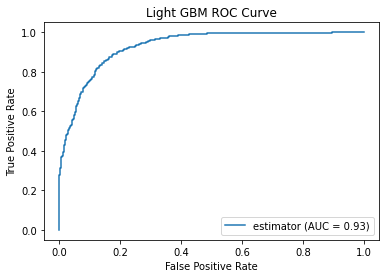

In [150]:
#ROC Curve

lgbm_probas_ = best_lgbm.predict_proba(X_test)
fpr, tpr, thresholds = metrics.roc_curve(y_test, lgbm_probas_[:, 1])
roc_auc = metrics.auc(fpr, tpr)
display = metrics.RocCurveDisplay(fpr=fpr, tpr=tpr, roc_auc=roc_auc,
                                  estimator_name='estimator')
display.plot()

plt.title("Light GBM ROC Curve")

plt.show()

#### Model explanation

##### Default feature importance

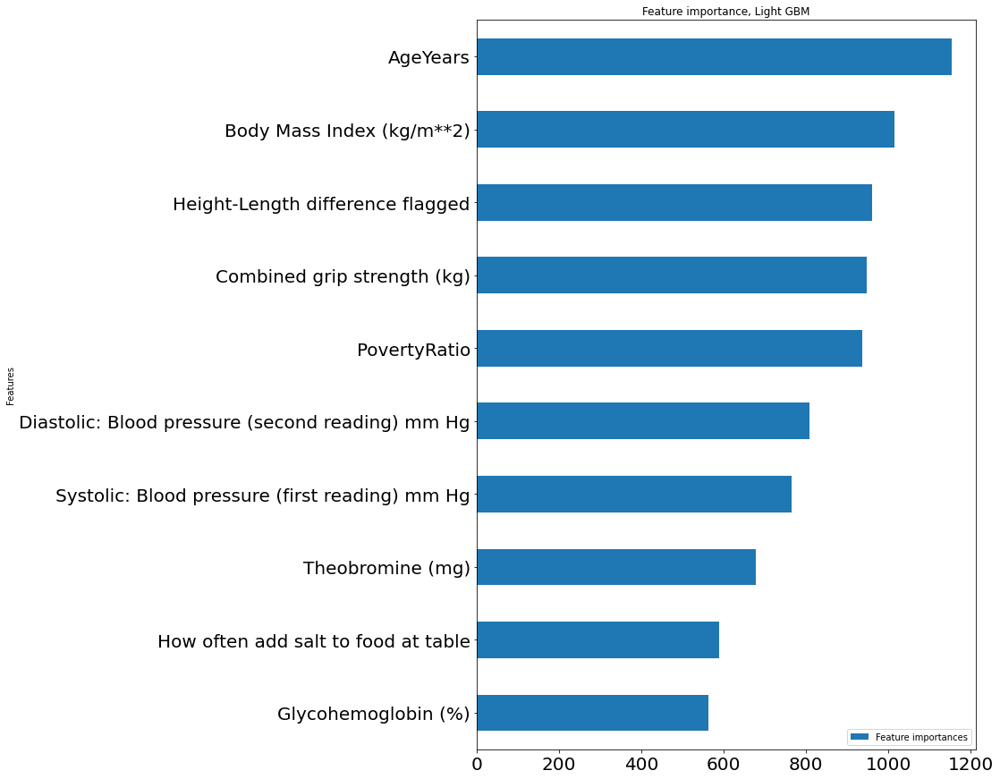

In [151]:
#Features used
feature_imp = best_lgbm.feature_importances_

importance_index_lgbm = np.nonzero(feature_imp)[0]

feature_importance = pd.DataFrame({'Features':feature_selected_cols ,'Feature importances':feature_imp})
feature_importance.sort_values(by='Feature importances', ascending=False).head(10).sort_values(by = 'Feature importances').plot(kind='barh',x='Features',y='Feature importances', figsize=(10,15),fontsize=20, title='Feature importance, Light GBM')
plt.show()

##### SHAP

Global explanation

LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


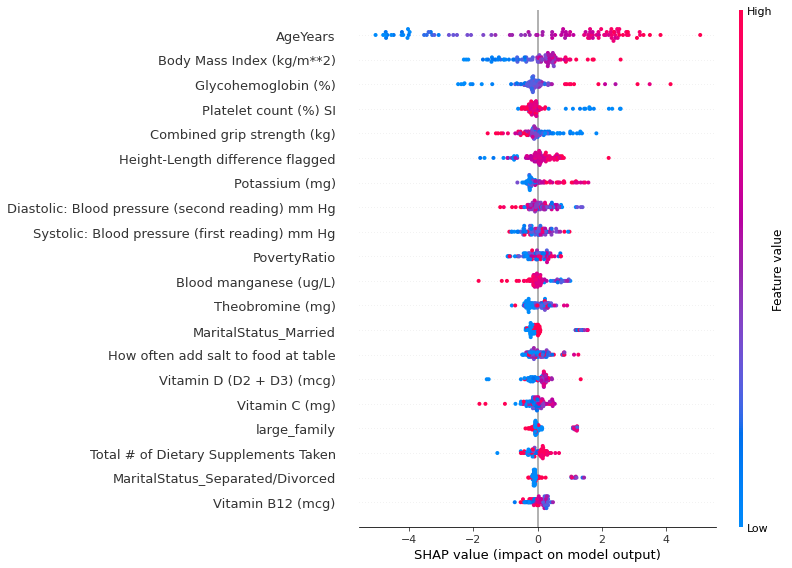

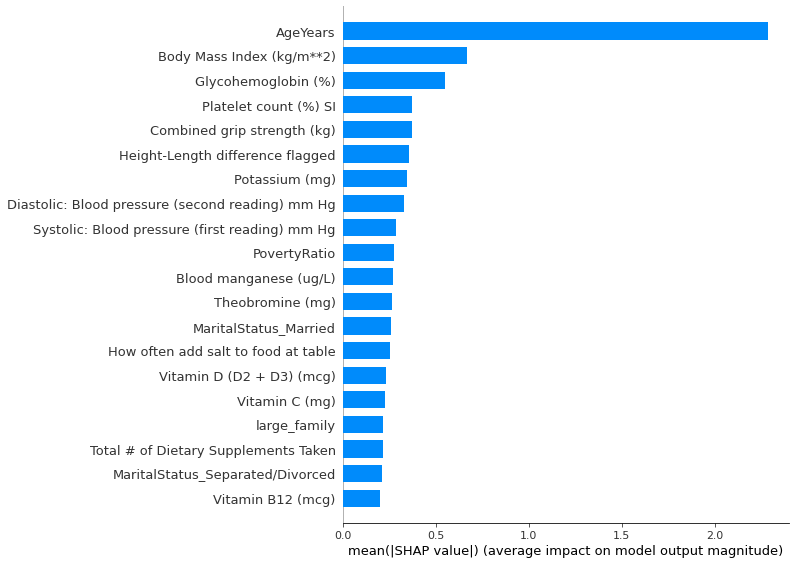

Local force plot for single sample


In [152]:
### SHAP
# Fit shap with sample of 100. Can change to 1 to visualize local data

sample_num_to_explain = 100 # How many sample points to include
class_to_explain = 1 # Explain with respect to which predictive label
single_sample_num = 0 # When plotting local explanation, which sample num

X100 = shap.utils.sample(X_train, sample_num_to_explain) # Sample to use as background distribution
explainer = shap.TreeExplainer(best_lgbm)
shap_values = explainer.shap_values(X100)

# Shap values that explain predictions on class 1  shap_values[class]
shap.summary_plot(shap_values[1], X100)
shap.summary_plot(shap_values[1], X100, plot_type="bar")

print('Local force plot for single sample')
shap.force_plot(explainer.expected_value[1], shap_values[1][single_sample_num],X100.iloc[single_sample_num] )



##### LIME

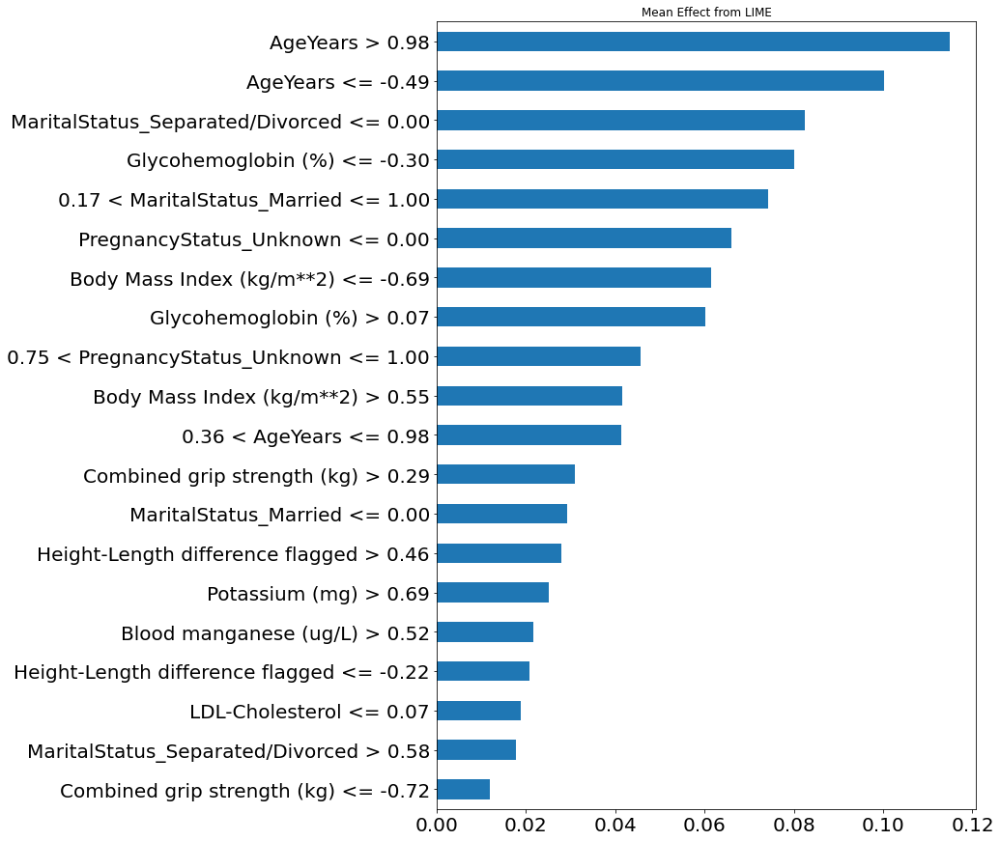

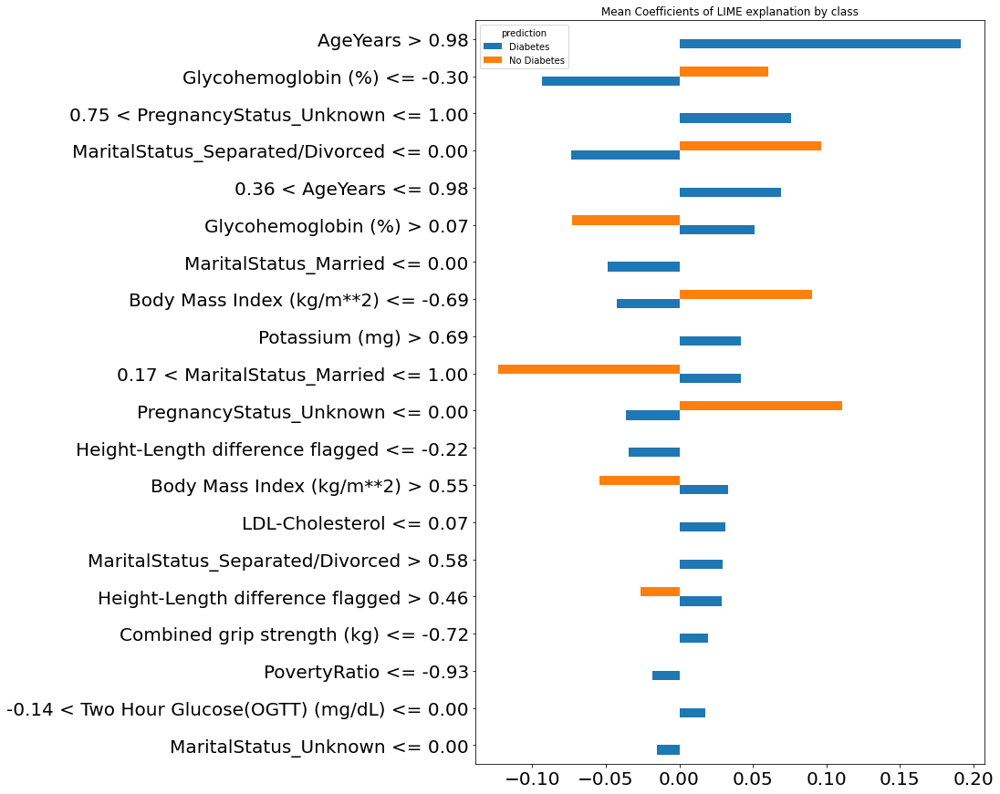

In [154]:
global_exp_lime (best_lgbm,X100)

##### Local explanation SHAP vs LIME

9


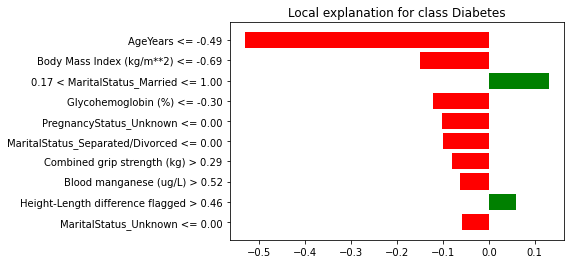

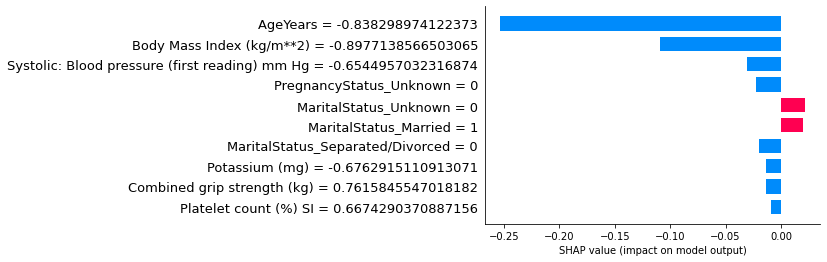

15


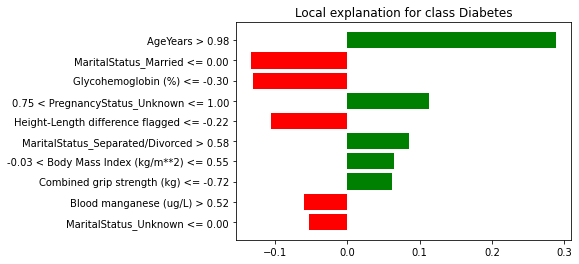

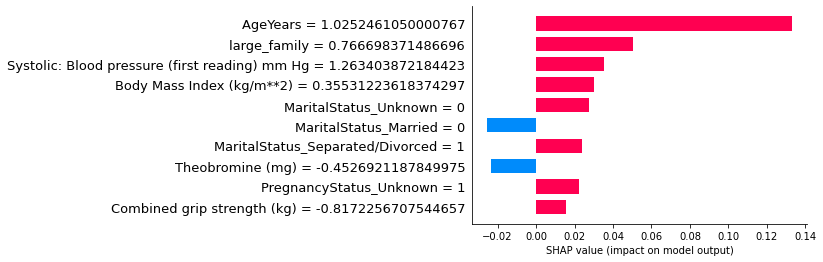

64


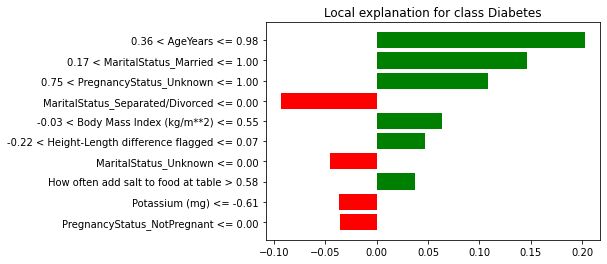

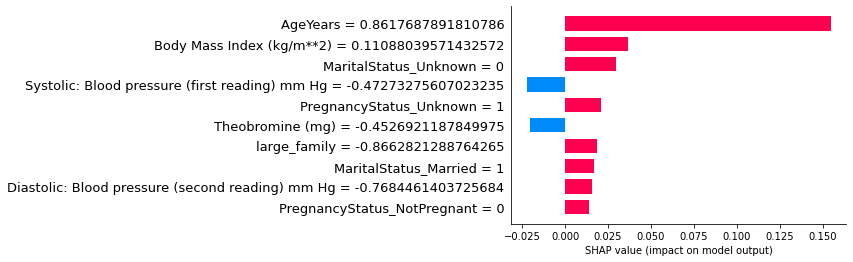

28


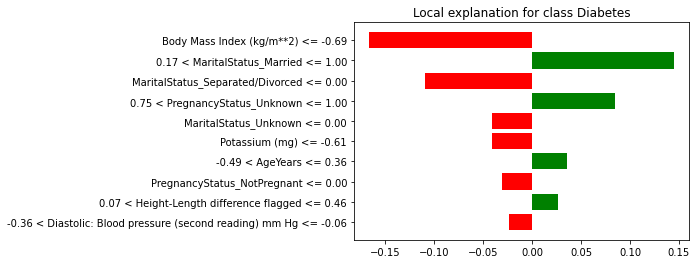

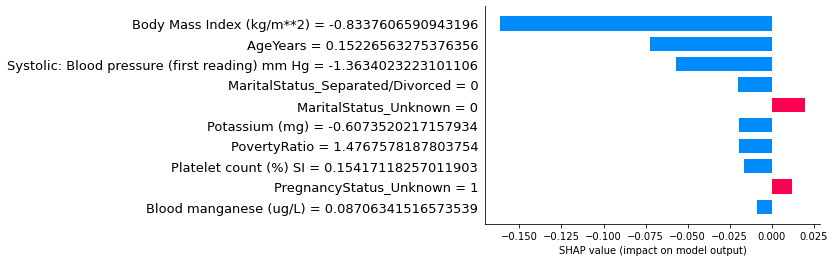

In [153]:
for x in local_list:
    print(x)
    local_exp_function(best_lgbm,x,X100)


##### Permutation Feature Importance

In [155]:
perm_lgbm = PermutationImportance(best_lgbm, random_state = 42).fit(X_test, y_test)
eli5.show_weights(perm_lgbm, feature_names = feature_selected_cols)

Weight,Feature
0.1316 ± 0.0103,AgeYears
0.0257 ± 0.0163,Body Mass Index (kg/m**2)
0.0201 ± 0.0108,Height-Length difference flagged
0.0167 ± 0.0083,Combined grip strength (kg)
0.0149 ± 0.0055,Glycohemoglobin (%)
0.0146 ± 0.0062,Systolic: Blood pressure (first reading) mm Hg
0.0142 ± 0.0050,PovertyRatio
0.0071 ± 0.0059,How often add salt to food at table
0.0060 ± 0.0045,Diastolic: Blood pressure (second reading) mm Hg
0.0048 ± 0.0081,Theobromine (mg)


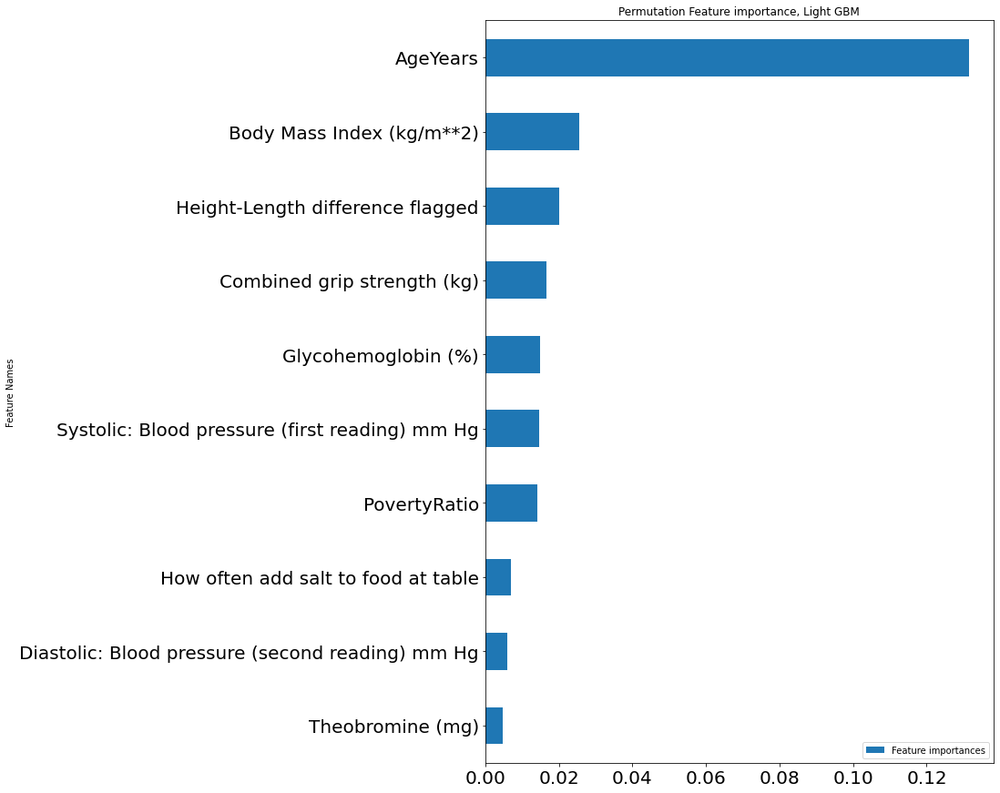

In [156]:
df_pfi_lgbm = pd.DataFrame({'Feature Names': feature_selected_cols,
                          'Feature importances': perm_lgbm.feature_importances_, 
                          })
df_pfi_lgbm.sort_values('Feature importances', ascending=False).head(10).sort_values('Feature importances').plot(kind='barh',x='Feature Names',y='Feature importances', figsize=(10,15),fontsize=20, title='Permutation Feature importance, Light GBM')
plt.show()

### ROC Curves

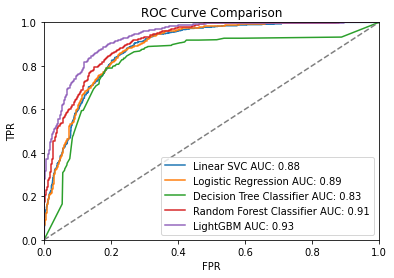

In [157]:
#Linear SVC
fpr_lsvc, tpr_lsvc, thresholds_lsvc = metrics.roc_curve(y_test, lsvc_probas_[:, 1])
roc_auc_lsvc = metrics.auc(fpr_lsvc, tpr_lsvc)


#Logistic Regression
fpr_lr, tpr_lr, thresholds_lr = metrics.roc_curve(y_test, lr_probas_[:, 1])
roc_auc_lr = metrics.auc(fpr_lr, tpr_lr)


# #Decision Tree Classifier
fpr_dtc, tpr_dtc, thresholds_dtc = metrics.roc_curve(y_test, dtc_probas_[:, 1])
roc_auc_dtc = metrics.auc(fpr_dtc, tpr_dtc)


# #Random Forest
fpr_rf, tpr_rf, thresholds_rf = metrics.roc_curve(y_test, rf_probas_[:, 1])
roc_auc_rf = metrics.auc(fpr_rf, tpr_rf)

# #Light GBM
fpr_lgbm, tpr_lgbm, thresholds_lgbm = metrics.roc_curve(y_test, lgbm_probas_[:, 1])
roc_auc_lgbm = metrics.auc(fpr_lgbm, tpr_lgbm)

        
plt.plot(fpr_lsvc, tpr_lsvc, label= "Linear SVC AUC: {:.2f}".format(roc_auc_lsvc, lsvc_probas_[:, 1]) )
plt.plot(fpr_lr, tpr_lr, label= "Logistic Regression AUC: {:.2f}".format(roc_auc_lr, lr_probas_[:, 1]))
plt.plot(fpr_dtc, tpr_dtc, label= "Decision Tree Classifier AUC: {:.2f}".format(roc_auc_dtc, dtc_probas_[:, 1]))
plt.plot(fpr_rf, tpr_rf, label= "Random Forest Classifier AUC: {:.2f}".format(roc_auc_rf, rf_probas_[:, 1]))
plt.plot(fpr_lgbm, tpr_lgbm, label= "LightGBM AUC: {:.2f}".format(roc_auc_lgbm, lgbm_probas_[:, 1]))

plt.plot([0,0.5,1], [0,0.5,1],'--',color = 'grey' )
plt.xlim([0, 1])
plt.ylim([0, 1])


plt.legend()
plt.xlabel("FPR")
plt.ylabel("TPR")
plt.title("ROC Curve Comparison")
plt.show()

In [143]:
######## Old pipeline #######
# preprocessor = ColumnTransformer(
#     transformers=[
#         ('num', StandardScaler(), num_cols ),
#         ("cat", Pipeline([('ohe', OneHotEncoder(handle_unknown='ignore'))]), cat_cols),
#     ]
#     , remainder='passthrough'
# )

# pipe = Pipeline([("preprocessor", preprocessor),('oversample', SMOTE()), ('classifier', LogisticRegression(penalty="l1", dual = False, solver='liblinear'))])

# param_grid = [
#     {   
#         'preprocessor__num':[StandardScaler(),RobustScaler(), QuantileTransformer()],
#         'classifier__C':[0.001, 0.01, 0.1,0.3, 0.5, 1]
#     }
# ]

# # Hyperparameter tuning and cross validation
# search_SVC = GridSearchCV(pipe, param_grid, cv=2, n_jobs=8, verbose=3)


# search_SVC.fit(X_train,np.ravel(y_train))

# y_preds = search_SVC.predict(X_test) 

# print('---------------------------------------------------------')
# print('Best params:', search_SVC.best_params_)
# print("Train score: ", search_SVC.score(X_train,np.ravel(y_train)))
# print("Test score: ", search_SVC.score(X_test,np.ravel(y_test)))
# print("Test precission: ", precision_score(np.ravel(y_test), y_preds))
# print("Test recall: ", recall_score(np.ravel(y_test), y_preds))


# #Confusion Matrix display
# cm_lsvc = confusion_matrix(y_test, y_preds)

# disp = ConfusionMatrixDisplay(confusion_matrix=cm_lsvc,
#                               display_labels=[0,1])
# disp.plot()

# plt.show()

